# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

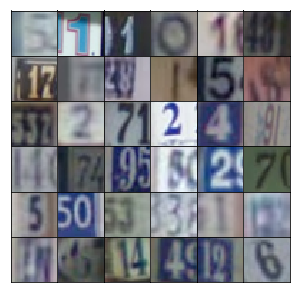

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU. 

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.5322... Generator Loss: 0.5481
Epoch 1/25... Discriminator Loss: 0.6252... Generator Loss: 1.1746
Epoch 1/25... Discriminator Loss: 0.2448... Generator Loss: 1.9433
Epoch 1/25... Discriminator Loss: 0.1259... Generator Loss: 3.7185
Epoch 1/25... Discriminator Loss: 0.1980... Generator Loss: 2.3215
Epoch 1/25... Discriminator Loss: 0.1028... Generator Loss: 3.0926
Epoch 1/25... Discriminator Loss: 0.1287... Generator Loss: 2.9693
Epoch 1/25... Discriminator Loss: 0.1887... Generator Loss: 2.6632
Epoch 1/25... Discriminator Loss: 0.4120... Generator Loss: 1.8965
Epoch 1/25... Discriminator Loss: 0.7197... Generator Loss: 2.4550


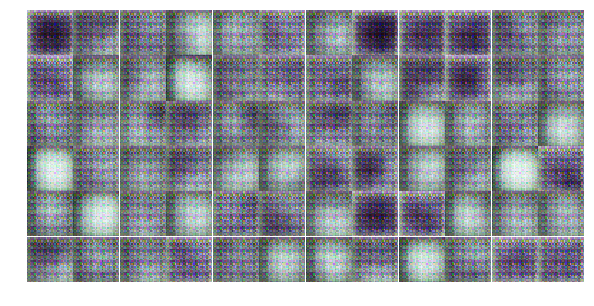

Epoch 1/25... Discriminator Loss: 0.6978... Generator Loss: 1.8418
Epoch 1/25... Discriminator Loss: 0.3190... Generator Loss: 2.0969
Epoch 1/25... Discriminator Loss: 0.7535... Generator Loss: 0.8014
Epoch 1/25... Discriminator Loss: 0.2183... Generator Loss: 2.5897
Epoch 1/25... Discriminator Loss: 0.4222... Generator Loss: 1.5121
Epoch 1/25... Discriminator Loss: 0.5255... Generator Loss: 1.5669
Epoch 1/25... Discriminator Loss: 0.2749... Generator Loss: 2.1678
Epoch 1/25... Discriminator Loss: 0.2700... Generator Loss: 2.3128
Epoch 1/25... Discriminator Loss: 1.9118... Generator Loss: 9.7109
Epoch 1/25... Discriminator Loss: 0.9098... Generator Loss: 1.1498


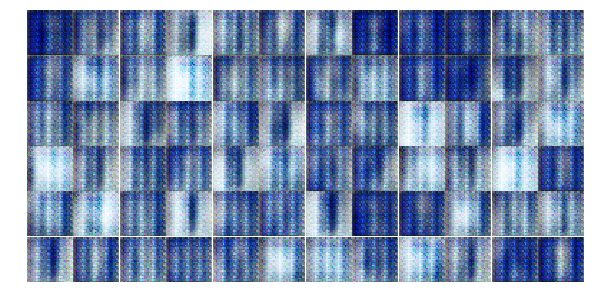

Epoch 1/25... Discriminator Loss: 0.6354... Generator Loss: 1.4480
Epoch 1/25... Discriminator Loss: 0.5054... Generator Loss: 2.7687
Epoch 1/25... Discriminator Loss: 0.5830... Generator Loss: 1.3461
Epoch 1/25... Discriminator Loss: 0.1913... Generator Loss: 2.4584
Epoch 1/25... Discriminator Loss: 0.3605... Generator Loss: 1.7698
Epoch 1/25... Discriminator Loss: 1.4872... Generator Loss: 5.2753
Epoch 1/25... Discriminator Loss: 1.0614... Generator Loss: 2.0427
Epoch 1/25... Discriminator Loss: 0.2998... Generator Loss: 2.8587
Epoch 1/25... Discriminator Loss: 0.5010... Generator Loss: 1.2577
Epoch 1/25... Discriminator Loss: 0.6150... Generator Loss: 2.3783


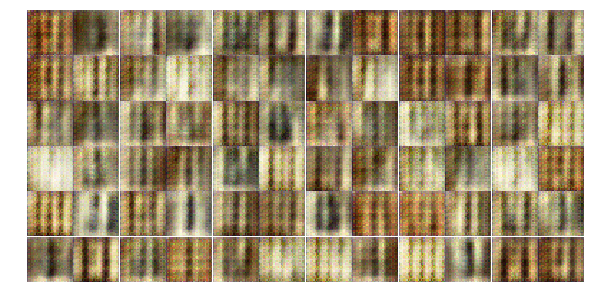

Epoch 1/25... Discriminator Loss: 0.8290... Generator Loss: 1.7618
Epoch 1/25... Discriminator Loss: 0.8100... Generator Loss: 1.3801
Epoch 1/25... Discriminator Loss: 0.5361... Generator Loss: 1.6833
Epoch 1/25... Discriminator Loss: 0.5671... Generator Loss: 1.6734
Epoch 1/25... Discriminator Loss: 0.3356... Generator Loss: 2.3442
Epoch 1/25... Discriminator Loss: 0.7300... Generator Loss: 1.0699
Epoch 1/25... Discriminator Loss: 0.7706... Generator Loss: 0.8382
Epoch 1/25... Discriminator Loss: 0.5674... Generator Loss: 2.0457
Epoch 1/25... Discriminator Loss: 1.1197... Generator Loss: 2.2877
Epoch 1/25... Discriminator Loss: 0.7884... Generator Loss: 1.6617


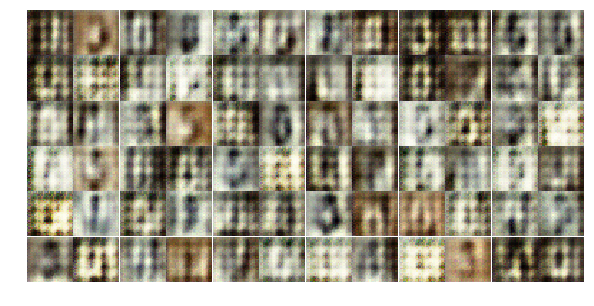

Epoch 1/25... Discriminator Loss: 1.3308... Generator Loss: 0.4990
Epoch 1/25... Discriminator Loss: 0.7933... Generator Loss: 1.9895
Epoch 1/25... Discriminator Loss: 1.1299... Generator Loss: 1.6321
Epoch 1/25... Discriminator Loss: 0.7323... Generator Loss: 1.3549
Epoch 1/25... Discriminator Loss: 0.8641... Generator Loss: 1.4027
Epoch 1/25... Discriminator Loss: 0.6323... Generator Loss: 1.4150
Epoch 1/25... Discriminator Loss: 0.5850... Generator Loss: 1.4874
Epoch 1/25... Discriminator Loss: 0.7514... Generator Loss: 1.1664
Epoch 1/25... Discriminator Loss: 0.9085... Generator Loss: 0.8243
Epoch 1/25... Discriminator Loss: 1.0948... Generator Loss: 1.3392


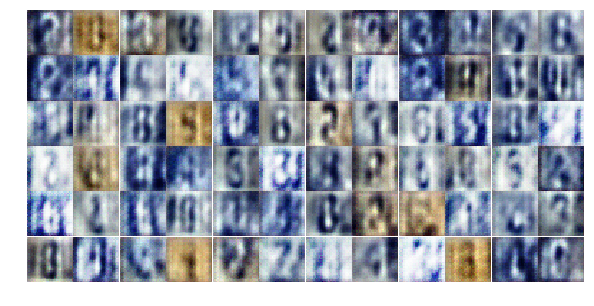

Epoch 1/25... Discriminator Loss: 0.8582... Generator Loss: 0.9272
Epoch 1/25... Discriminator Loss: 0.5885... Generator Loss: 1.3675
Epoch 1/25... Discriminator Loss: 0.9161... Generator Loss: 1.2922
Epoch 1/25... Discriminator Loss: 1.2384... Generator Loss: 0.5397
Epoch 1/25... Discriminator Loss: 0.7613... Generator Loss: 1.2102
Epoch 1/25... Discriminator Loss: 0.5357... Generator Loss: 1.4342
Epoch 1/25... Discriminator Loss: 0.8411... Generator Loss: 1.1033
Epoch 2/25... Discriminator Loss: 1.4784... Generator Loss: 1.3528
Epoch 2/25... Discriminator Loss: 0.8681... Generator Loss: 1.6385
Epoch 2/25... Discriminator Loss: 0.9658... Generator Loss: 0.7840


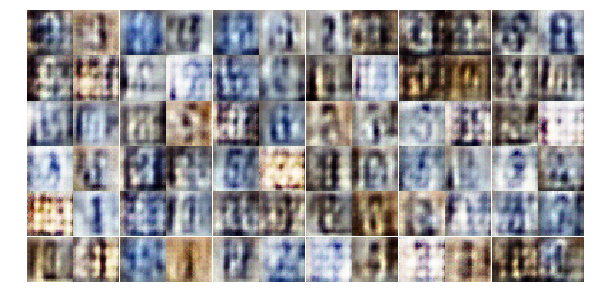

Epoch 2/25... Discriminator Loss: 1.1125... Generator Loss: 1.0425
Epoch 2/25... Discriminator Loss: 1.1480... Generator Loss: 1.0330
Epoch 2/25... Discriminator Loss: 1.3855... Generator Loss: 1.2803
Epoch 2/25... Discriminator Loss: 1.0179... Generator Loss: 1.1612
Epoch 2/25... Discriminator Loss: 1.2117... Generator Loss: 0.8569
Epoch 2/25... Discriminator Loss: 0.9628... Generator Loss: 1.0108
Epoch 2/25... Discriminator Loss: 1.0298... Generator Loss: 1.1926
Epoch 2/25... Discriminator Loss: 0.8159... Generator Loss: 1.1774
Epoch 2/25... Discriminator Loss: 1.1649... Generator Loss: 0.7272
Epoch 2/25... Discriminator Loss: 0.9136... Generator Loss: 1.4053


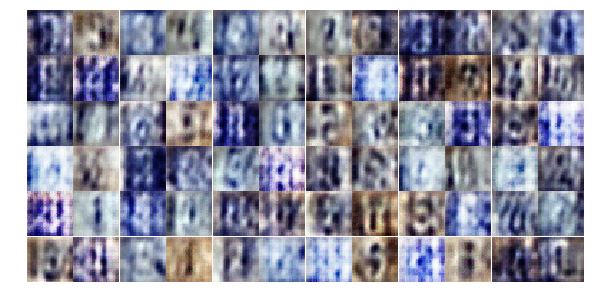

Epoch 2/25... Discriminator Loss: 1.2387... Generator Loss: 0.6773
Epoch 2/25... Discriminator Loss: 0.8287... Generator Loss: 1.3344
Epoch 2/25... Discriminator Loss: 0.8628... Generator Loss: 1.3645
Epoch 2/25... Discriminator Loss: 0.8492... Generator Loss: 1.1667
Epoch 2/25... Discriminator Loss: 1.1305... Generator Loss: 0.8671
Epoch 2/25... Discriminator Loss: 1.0904... Generator Loss: 0.8696
Epoch 2/25... Discriminator Loss: 1.3447... Generator Loss: 0.5122
Epoch 2/25... Discriminator Loss: 1.1357... Generator Loss: 0.7240
Epoch 2/25... Discriminator Loss: 1.3066... Generator Loss: 0.8244
Epoch 2/25... Discriminator Loss: 1.0838... Generator Loss: 0.7105


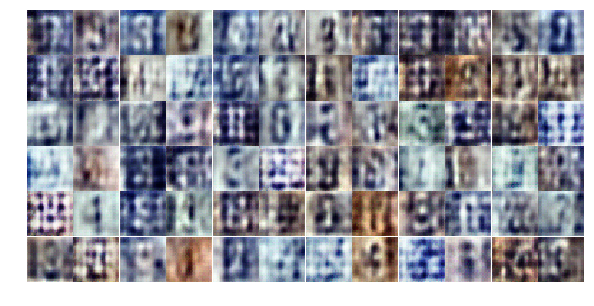

Epoch 2/25... Discriminator Loss: 1.1943... Generator Loss: 0.7208
Epoch 2/25... Discriminator Loss: 1.0050... Generator Loss: 1.2085
Epoch 2/25... Discriminator Loss: 1.2205... Generator Loss: 0.7329
Epoch 2/25... Discriminator Loss: 0.9582... Generator Loss: 1.0080
Epoch 2/25... Discriminator Loss: 1.0782... Generator Loss: 1.3433
Epoch 2/25... Discriminator Loss: 0.9768... Generator Loss: 1.1042
Epoch 2/25... Discriminator Loss: 1.3132... Generator Loss: 0.6207
Epoch 2/25... Discriminator Loss: 1.1852... Generator Loss: 0.6325
Epoch 2/25... Discriminator Loss: 1.0440... Generator Loss: 0.9607
Epoch 2/25... Discriminator Loss: 0.9972... Generator Loss: 1.2750


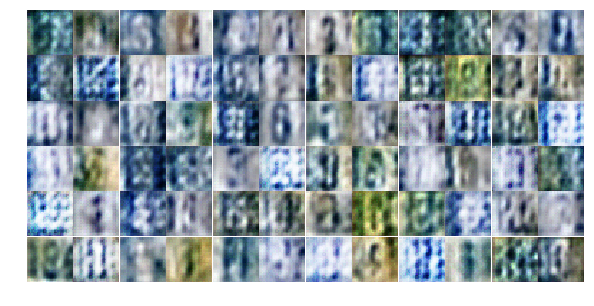

Epoch 2/25... Discriminator Loss: 1.0577... Generator Loss: 1.3120
Epoch 2/25... Discriminator Loss: 1.1771... Generator Loss: 0.6547
Epoch 2/25... Discriminator Loss: 1.3304... Generator Loss: 0.5696
Epoch 2/25... Discriminator Loss: 1.4693... Generator Loss: 0.6238
Epoch 2/25... Discriminator Loss: 0.9732... Generator Loss: 0.9699
Epoch 2/25... Discriminator Loss: 1.0909... Generator Loss: 0.9047
Epoch 2/25... Discriminator Loss: 1.0926... Generator Loss: 1.0075
Epoch 2/25... Discriminator Loss: 1.1713... Generator Loss: 0.9909
Epoch 2/25... Discriminator Loss: 0.9616... Generator Loss: 1.0098
Epoch 2/25... Discriminator Loss: 1.4312... Generator Loss: 0.8370


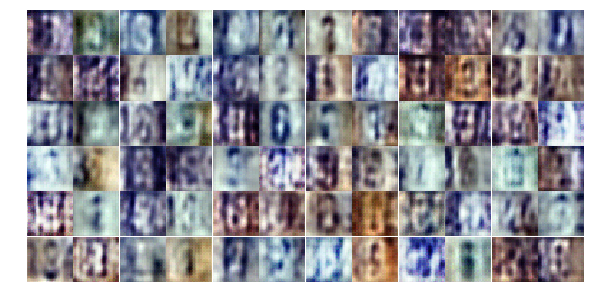

Epoch 2/25... Discriminator Loss: 0.8767... Generator Loss: 1.3028
Epoch 2/25... Discriminator Loss: 1.2980... Generator Loss: 0.9472
Epoch 2/25... Discriminator Loss: 0.7064... Generator Loss: 1.2338
Epoch 2/25... Discriminator Loss: 0.8977... Generator Loss: 1.1241
Epoch 2/25... Discriminator Loss: 1.1699... Generator Loss: 0.9299
Epoch 2/25... Discriminator Loss: 1.3695... Generator Loss: 0.7030
Epoch 2/25... Discriminator Loss: 1.1557... Generator Loss: 1.1050
Epoch 2/25... Discriminator Loss: 0.8692... Generator Loss: 1.4515
Epoch 2/25... Discriminator Loss: 0.9123... Generator Loss: 1.4001
Epoch 2/25... Discriminator Loss: 1.1490... Generator Loss: 0.8856


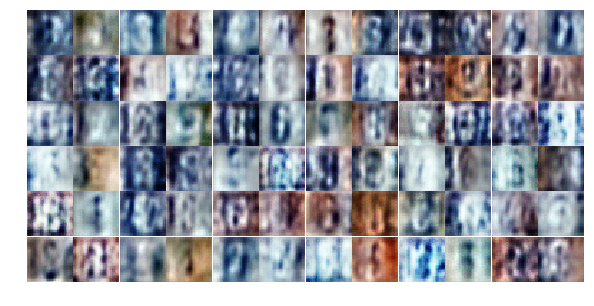

Epoch 2/25... Discriminator Loss: 1.1482... Generator Loss: 1.0301
Epoch 2/25... Discriminator Loss: 0.9312... Generator Loss: 1.4608
Epoch 2/25... Discriminator Loss: 1.0773... Generator Loss: 0.6278
Epoch 2/25... Discriminator Loss: 1.3696... Generator Loss: 0.6771
Epoch 3/25... Discriminator Loss: 1.1758... Generator Loss: 1.3975
Epoch 3/25... Discriminator Loss: 0.9301... Generator Loss: 0.9771
Epoch 3/25... Discriminator Loss: 0.7229... Generator Loss: 1.1694
Epoch 3/25... Discriminator Loss: 1.5786... Generator Loss: 0.4272
Epoch 3/25... Discriminator Loss: 0.9400... Generator Loss: 1.0830
Epoch 3/25... Discriminator Loss: 0.6819... Generator Loss: 1.4832


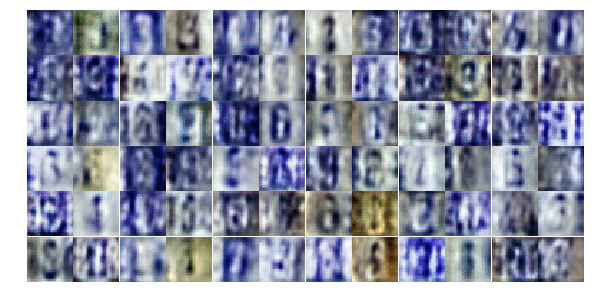

Epoch 3/25... Discriminator Loss: 0.6953... Generator Loss: 1.2591
Epoch 3/25... Discriminator Loss: 1.1355... Generator Loss: 0.6646
Epoch 3/25... Discriminator Loss: 0.9708... Generator Loss: 1.0594
Epoch 3/25... Discriminator Loss: 1.0236... Generator Loss: 0.7858
Epoch 3/25... Discriminator Loss: 0.8082... Generator Loss: 1.2369
Epoch 3/25... Discriminator Loss: 1.0837... Generator Loss: 1.0860
Epoch 3/25... Discriminator Loss: 1.4873... Generator Loss: 0.6440
Epoch 3/25... Discriminator Loss: 0.6670... Generator Loss: 1.2204
Epoch 3/25... Discriminator Loss: 0.9619... Generator Loss: 1.0440
Epoch 3/25... Discriminator Loss: 0.7554... Generator Loss: 1.1810


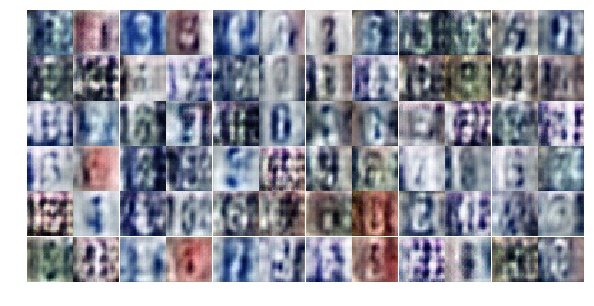

Epoch 3/25... Discriminator Loss: 0.7341... Generator Loss: 1.2233
Epoch 3/25... Discriminator Loss: 1.0361... Generator Loss: 0.9833
Epoch 3/25... Discriminator Loss: 0.8238... Generator Loss: 1.0998
Epoch 3/25... Discriminator Loss: 0.7120... Generator Loss: 1.3750
Epoch 3/25... Discriminator Loss: 1.1871... Generator Loss: 0.8289
Epoch 3/25... Discriminator Loss: 0.9529... Generator Loss: 1.2061
Epoch 3/25... Discriminator Loss: 0.9742... Generator Loss: 1.3276
Epoch 3/25... Discriminator Loss: 1.1841... Generator Loss: 1.2249
Epoch 3/25... Discriminator Loss: 0.9712... Generator Loss: 1.6119
Epoch 3/25... Discriminator Loss: 0.8118... Generator Loss: 0.8251


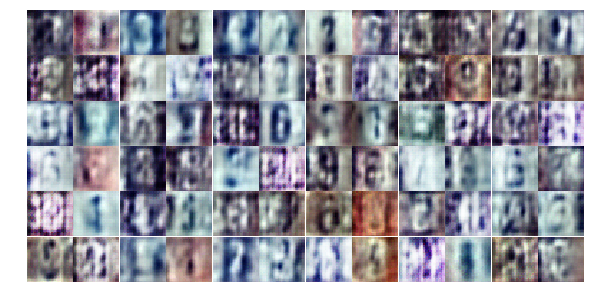

Epoch 3/25... Discriminator Loss: 0.8774... Generator Loss: 0.9988
Epoch 3/25... Discriminator Loss: 0.6793... Generator Loss: 1.3656
Epoch 3/25... Discriminator Loss: 0.6101... Generator Loss: 1.6402
Epoch 3/25... Discriminator Loss: 1.0783... Generator Loss: 2.1540
Epoch 3/25... Discriminator Loss: 0.8290... Generator Loss: 1.4437
Epoch 3/25... Discriminator Loss: 1.3947... Generator Loss: 0.4304
Epoch 3/25... Discriminator Loss: 1.1375... Generator Loss: 0.8605
Epoch 3/25... Discriminator Loss: 0.5256... Generator Loss: 1.4785
Epoch 3/25... Discriminator Loss: 0.5417... Generator Loss: 1.4822
Epoch 3/25... Discriminator Loss: 1.0314... Generator Loss: 1.1151


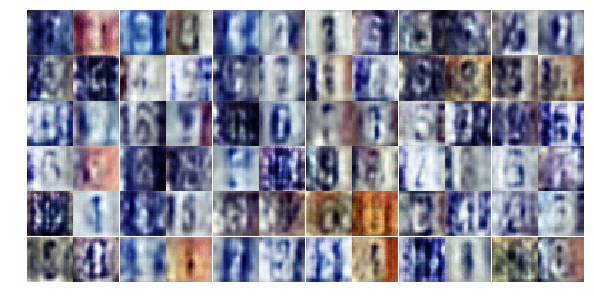

Epoch 3/25... Discriminator Loss: 0.5434... Generator Loss: 1.9478
Epoch 3/25... Discriminator Loss: 0.5673... Generator Loss: 1.4883
Epoch 3/25... Discriminator Loss: 0.4489... Generator Loss: 1.5385
Epoch 3/25... Discriminator Loss: 0.7190... Generator Loss: 2.0851
Epoch 3/25... Discriminator Loss: 0.7529... Generator Loss: 1.2479
Epoch 3/25... Discriminator Loss: 1.1297... Generator Loss: 0.7498
Epoch 3/25... Discriminator Loss: 0.7658... Generator Loss: 1.4154
Epoch 3/25... Discriminator Loss: 1.5365... Generator Loss: 0.3851
Epoch 3/25... Discriminator Loss: 1.3724... Generator Loss: 3.1008
Epoch 3/25... Discriminator Loss: 1.3374... Generator Loss: 0.5407


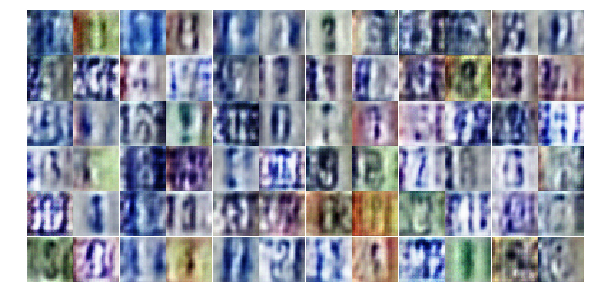

Epoch 3/25... Discriminator Loss: 0.5860... Generator Loss: 2.3138
Epoch 3/25... Discriminator Loss: 0.9794... Generator Loss: 2.5179
Epoch 3/25... Discriminator Loss: 0.7295... Generator Loss: 1.8157
Epoch 3/25... Discriminator Loss: 0.5679... Generator Loss: 1.5225
Epoch 3/25... Discriminator Loss: 0.7350... Generator Loss: 1.4084
Epoch 3/25... Discriminator Loss: 0.6636... Generator Loss: 2.0063
Epoch 3/25... Discriminator Loss: 1.0792... Generator Loss: 2.1417
Epoch 3/25... Discriminator Loss: 0.5505... Generator Loss: 1.2675
Epoch 3/25... Discriminator Loss: 0.6832... Generator Loss: 1.0767
Epoch 3/25... Discriminator Loss: 0.9454... Generator Loss: 0.6778


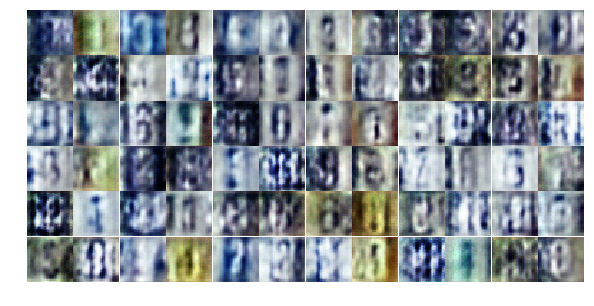

Epoch 3/25... Discriminator Loss: 1.1259... Generator Loss: 1.1009
Epoch 4/25... Discriminator Loss: 0.9883... Generator Loss: 0.8574
Epoch 4/25... Discriminator Loss: 0.6713... Generator Loss: 2.2375
Epoch 4/25... Discriminator Loss: 0.6827... Generator Loss: 1.1700
Epoch 4/25... Discriminator Loss: 0.4640... Generator Loss: 1.7059
Epoch 4/25... Discriminator Loss: 0.6963... Generator Loss: 0.9636
Epoch 4/25... Discriminator Loss: 1.2406... Generator Loss: 2.0131
Epoch 4/25... Discriminator Loss: 0.7491... Generator Loss: 1.7113
Epoch 4/25... Discriminator Loss: 0.5725... Generator Loss: 1.6524
Epoch 4/25... Discriminator Loss: 0.6034... Generator Loss: 1.1362


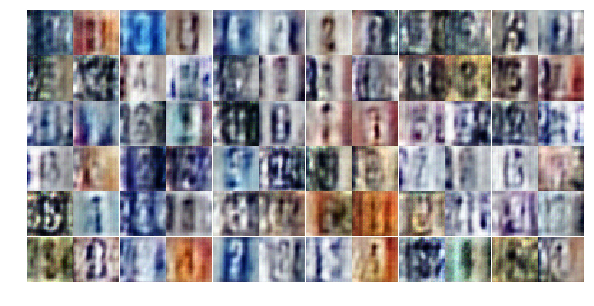

Epoch 4/25... Discriminator Loss: 0.4926... Generator Loss: 1.4093
Epoch 4/25... Discriminator Loss: 0.4162... Generator Loss: 2.2238
Epoch 4/25... Discriminator Loss: 0.6664... Generator Loss: 1.2445
Epoch 4/25... Discriminator Loss: 1.6046... Generator Loss: 0.3264
Epoch 4/25... Discriminator Loss: 0.6356... Generator Loss: 1.9287
Epoch 4/25... Discriminator Loss: 0.3050... Generator Loss: 2.3064
Epoch 4/25... Discriminator Loss: 1.3273... Generator Loss: 3.0406
Epoch 4/25... Discriminator Loss: 1.2128... Generator Loss: 0.7128
Epoch 4/25... Discriminator Loss: 0.5964... Generator Loss: 1.2566
Epoch 4/25... Discriminator Loss: 0.5669... Generator Loss: 1.1816


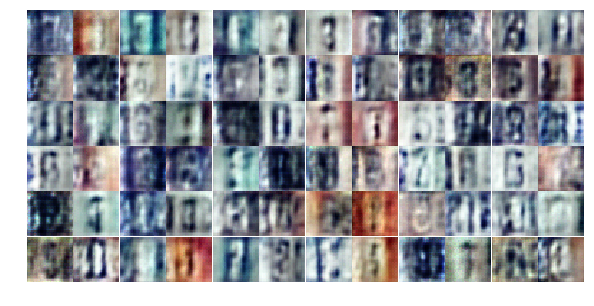

Epoch 4/25... Discriminator Loss: 0.6656... Generator Loss: 2.0032
Epoch 4/25... Discriminator Loss: 0.5162... Generator Loss: 1.4194
Epoch 4/25... Discriminator Loss: 1.0394... Generator Loss: 0.6456
Epoch 4/25... Discriminator Loss: 0.5996... Generator Loss: 1.2616
Epoch 4/25... Discriminator Loss: 0.6568... Generator Loss: 1.8137
Epoch 4/25... Discriminator Loss: 0.5764... Generator Loss: 1.8870
Epoch 4/25... Discriminator Loss: 2.1204... Generator Loss: 0.2198
Epoch 4/25... Discriminator Loss: 1.0458... Generator Loss: 0.8422
Epoch 4/25... Discriminator Loss: 0.5376... Generator Loss: 1.7254
Epoch 4/25... Discriminator Loss: 0.6102... Generator Loss: 1.1356


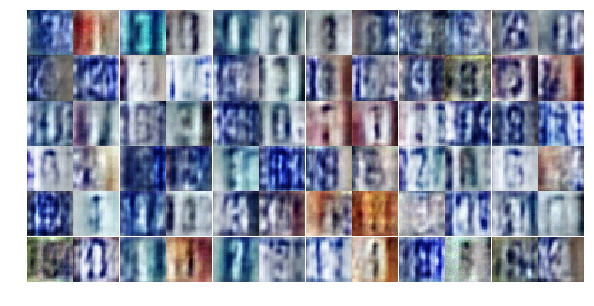

Epoch 4/25... Discriminator Loss: 0.5816... Generator Loss: 1.2664
Epoch 4/25... Discriminator Loss: 0.8446... Generator Loss: 0.8407
Epoch 4/25... Discriminator Loss: 0.4805... Generator Loss: 1.5456
Epoch 4/25... Discriminator Loss: 0.7202... Generator Loss: 1.5822
Epoch 4/25... Discriminator Loss: 0.5649... Generator Loss: 1.4514
Epoch 4/25... Discriminator Loss: 0.5555... Generator Loss: 1.2114
Epoch 4/25... Discriminator Loss: 0.3888... Generator Loss: 2.1488
Epoch 4/25... Discriminator Loss: 0.8259... Generator Loss: 2.5180
Epoch 4/25... Discriminator Loss: 0.4313... Generator Loss: 1.4099
Epoch 4/25... Discriminator Loss: 0.8285... Generator Loss: 0.7132


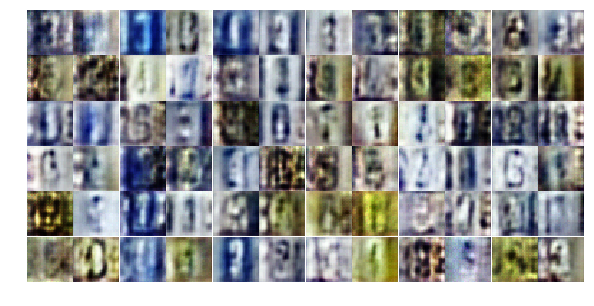

Epoch 4/25... Discriminator Loss: 1.1569... Generator Loss: 0.6527
Epoch 4/25... Discriminator Loss: 0.3217... Generator Loss: 1.7571
Epoch 4/25... Discriminator Loss: 2.8913... Generator Loss: 3.5121
Epoch 4/25... Discriminator Loss: 0.6478... Generator Loss: 2.8490
Epoch 4/25... Discriminator Loss: 0.4872... Generator Loss: 1.6042
Epoch 4/25... Discriminator Loss: 0.7758... Generator Loss: 1.0502
Epoch 4/25... Discriminator Loss: 0.4102... Generator Loss: 1.6126
Epoch 4/25... Discriminator Loss: 0.6673... Generator Loss: 1.3946
Epoch 4/25... Discriminator Loss: 0.4595... Generator Loss: 1.6129
Epoch 4/25... Discriminator Loss: 0.4669... Generator Loss: 3.0482


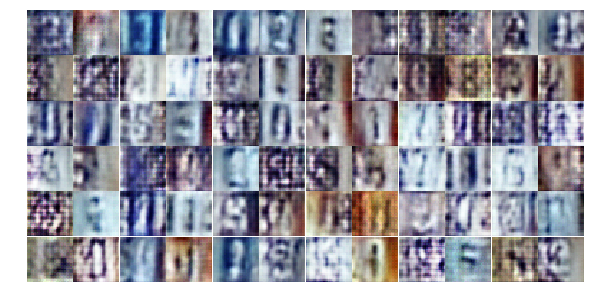

Epoch 4/25... Discriminator Loss: 0.6623... Generator Loss: 1.3038
Epoch 4/25... Discriminator Loss: 0.8249... Generator Loss: 0.8952
Epoch 4/25... Discriminator Loss: 0.6006... Generator Loss: 2.0827
Epoch 4/25... Discriminator Loss: 0.9298... Generator Loss: 2.4232
Epoch 4/25... Discriminator Loss: 0.6481... Generator Loss: 1.2167
Epoch 4/25... Discriminator Loss: 1.0570... Generator Loss: 0.7179
Epoch 4/25... Discriminator Loss: 0.7164... Generator Loss: 0.9439
Epoch 4/25... Discriminator Loss: 0.4227... Generator Loss: 1.5744
Epoch 4/25... Discriminator Loss: 0.9398... Generator Loss: 0.9526
Epoch 5/25... Discriminator Loss: 0.5892... Generator Loss: 1.5113


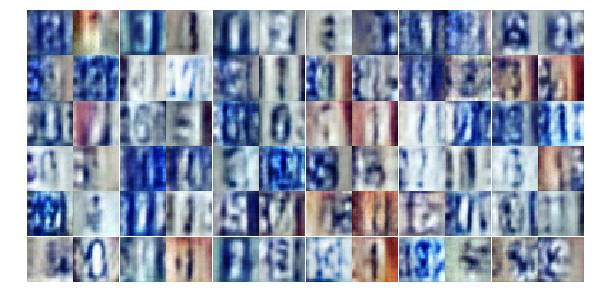

Epoch 5/25... Discriminator Loss: 0.6131... Generator Loss: 1.1273
Epoch 5/25... Discriminator Loss: 0.4013... Generator Loss: 1.6768
Epoch 5/25... Discriminator Loss: 0.5371... Generator Loss: 1.6341
Epoch 5/25... Discriminator Loss: 0.5384... Generator Loss: 1.2695
Epoch 5/25... Discriminator Loss: 0.7775... Generator Loss: 2.4863
Epoch 5/25... Discriminator Loss: 0.7358... Generator Loss: 1.0305
Epoch 5/25... Discriminator Loss: 0.3627... Generator Loss: 1.9881
Epoch 5/25... Discriminator Loss: 0.6272... Generator Loss: 1.1636
Epoch 5/25... Discriminator Loss: 0.5926... Generator Loss: 1.4090
Epoch 5/25... Discriminator Loss: 0.6649... Generator Loss: 1.2117


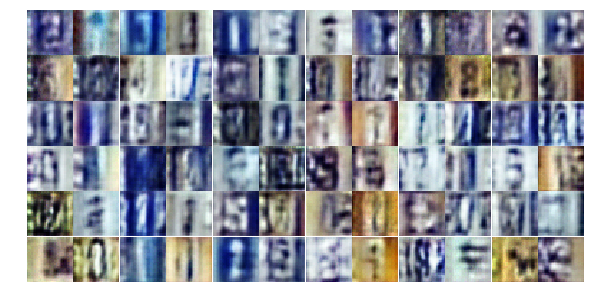

Epoch 5/25... Discriminator Loss: 1.5110... Generator Loss: 0.4395
Epoch 5/25... Discriminator Loss: 0.5816... Generator Loss: 2.2464
Epoch 5/25... Discriminator Loss: 0.4877... Generator Loss: 1.6585
Epoch 5/25... Discriminator Loss: 1.2095... Generator Loss: 0.5253
Epoch 5/25... Discriminator Loss: 0.6916... Generator Loss: 1.0041
Epoch 5/25... Discriminator Loss: 0.4908... Generator Loss: 1.4794
Epoch 5/25... Discriminator Loss: 0.7953... Generator Loss: 0.9239
Epoch 5/25... Discriminator Loss: 0.5476... Generator Loss: 1.5749
Epoch 5/25... Discriminator Loss: 0.5216... Generator Loss: 1.4953
Epoch 5/25... Discriminator Loss: 0.5025... Generator Loss: 1.4973


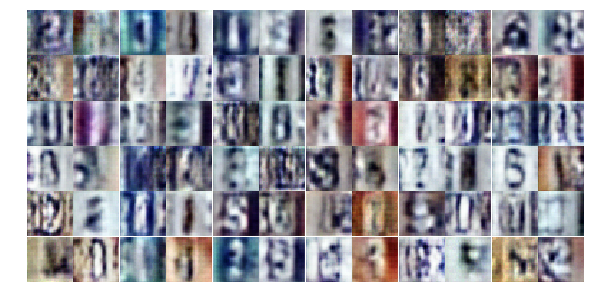

Epoch 5/25... Discriminator Loss: 0.4032... Generator Loss: 1.7574
Epoch 5/25... Discriminator Loss: 0.8324... Generator Loss: 1.3313
Epoch 5/25... Discriminator Loss: 0.4793... Generator Loss: 1.4515
Epoch 5/25... Discriminator Loss: 0.3425... Generator Loss: 2.0292
Epoch 5/25... Discriminator Loss: 1.2385... Generator Loss: 0.5565
Epoch 5/25... Discriminator Loss: 0.7814... Generator Loss: 0.9059
Epoch 5/25... Discriminator Loss: 0.8910... Generator Loss: 0.7384
Epoch 5/25... Discriminator Loss: 0.5190... Generator Loss: 1.7559
Epoch 5/25... Discriminator Loss: 1.9097... Generator Loss: 0.2529
Epoch 5/25... Discriminator Loss: 0.5950... Generator Loss: 1.4069


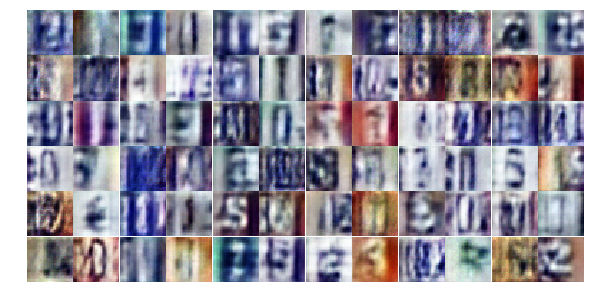

Epoch 5/25... Discriminator Loss: 0.6141... Generator Loss: 1.4590
Epoch 5/25... Discriminator Loss: 0.3807... Generator Loss: 1.7894
Epoch 5/25... Discriminator Loss: 0.4332... Generator Loss: 1.8106
Epoch 5/25... Discriminator Loss: 0.4866... Generator Loss: 1.3024
Epoch 5/25... Discriminator Loss: 0.7298... Generator Loss: 1.4444
Epoch 5/25... Discriminator Loss: 0.5387... Generator Loss: 2.6041
Epoch 5/25... Discriminator Loss: 1.0015... Generator Loss: 0.6087
Epoch 5/25... Discriminator Loss: 0.6095... Generator Loss: 1.1535
Epoch 5/25... Discriminator Loss: 0.9151... Generator Loss: 0.6860
Epoch 5/25... Discriminator Loss: 0.2629... Generator Loss: 2.2328


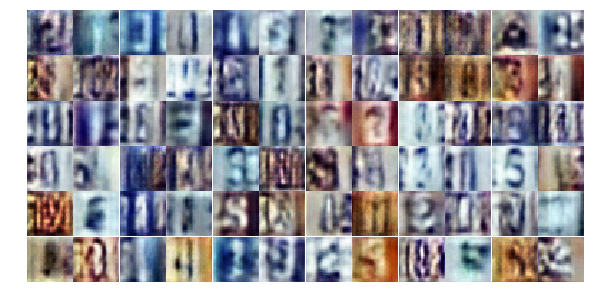

Epoch 5/25... Discriminator Loss: 0.4571... Generator Loss: 1.3823
Epoch 5/25... Discriminator Loss: 0.3204... Generator Loss: 1.6751
Epoch 5/25... Discriminator Loss: 1.2272... Generator Loss: 0.4651
Epoch 5/25... Discriminator Loss: 0.8551... Generator Loss: 0.8473
Epoch 5/25... Discriminator Loss: 1.0269... Generator Loss: 0.7555
Epoch 5/25... Discriminator Loss: 0.7995... Generator Loss: 1.2856
Epoch 5/25... Discriminator Loss: 0.5581... Generator Loss: 1.7755
Epoch 5/25... Discriminator Loss: 0.8218... Generator Loss: 0.8723
Epoch 5/25... Discriminator Loss: 0.6641... Generator Loss: 1.0823
Epoch 5/25... Discriminator Loss: 0.5232... Generator Loss: 2.1848


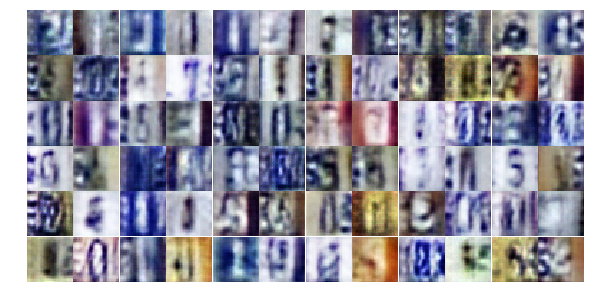

Epoch 5/25... Discriminator Loss: 1.1467... Generator Loss: 0.5184
Epoch 5/25... Discriminator Loss: 0.7955... Generator Loss: 0.8470
Epoch 5/25... Discriminator Loss: 0.6083... Generator Loss: 1.5664
Epoch 5/25... Discriminator Loss: 0.5624... Generator Loss: 1.2833
Epoch 5/25... Discriminator Loss: 0.4153... Generator Loss: 1.8519
Epoch 5/25... Discriminator Loss: 0.5888... Generator Loss: 1.3753
Epoch 6/25... Discriminator Loss: 0.5561... Generator Loss: 1.2053
Epoch 6/25... Discriminator Loss: 0.3837... Generator Loss: 1.5522
Epoch 6/25... Discriminator Loss: 0.4705... Generator Loss: 2.3070
Epoch 6/25... Discriminator Loss: 0.6066... Generator Loss: 1.1224


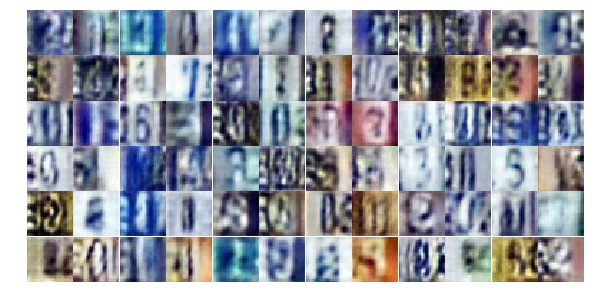

Epoch 6/25... Discriminator Loss: 0.5881... Generator Loss: 1.1899
Epoch 6/25... Discriminator Loss: 0.4945... Generator Loss: 1.6289
Epoch 6/25... Discriminator Loss: 0.5119... Generator Loss: 2.2987
Epoch 6/25... Discriminator Loss: 0.5594... Generator Loss: 1.2588
Epoch 6/25... Discriminator Loss: 0.5768... Generator Loss: 1.1302
Epoch 6/25... Discriminator Loss: 0.5501... Generator Loss: 1.1863
Epoch 6/25... Discriminator Loss: 0.4749... Generator Loss: 1.3871
Epoch 6/25... Discriminator Loss: 0.5600... Generator Loss: 1.1883
Epoch 6/25... Discriminator Loss: 0.4849... Generator Loss: 1.3546
Epoch 6/25... Discriminator Loss: 2.4800... Generator Loss: 4.9978


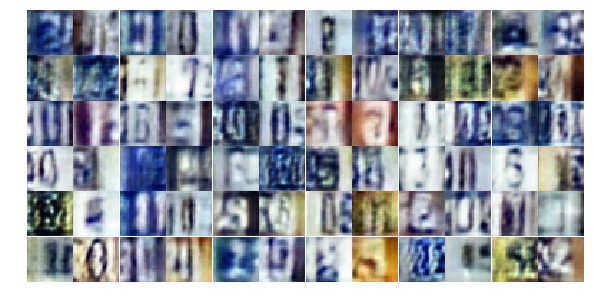

Epoch 6/25... Discriminator Loss: 0.7407... Generator Loss: 1.5192
Epoch 6/25... Discriminator Loss: 1.0817... Generator Loss: 0.8060
Epoch 6/25... Discriminator Loss: 0.6357... Generator Loss: 1.2737
Epoch 6/25... Discriminator Loss: 0.3589... Generator Loss: 1.7913
Epoch 6/25... Discriminator Loss: 0.3950... Generator Loss: 1.9700
Epoch 6/25... Discriminator Loss: 0.6047... Generator Loss: 2.1454
Epoch 6/25... Discriminator Loss: 0.5560... Generator Loss: 1.2279
Epoch 6/25... Discriminator Loss: 0.9979... Generator Loss: 0.7356
Epoch 6/25... Discriminator Loss: 0.7632... Generator Loss: 2.8546
Epoch 6/25... Discriminator Loss: 0.8815... Generator Loss: 2.1548


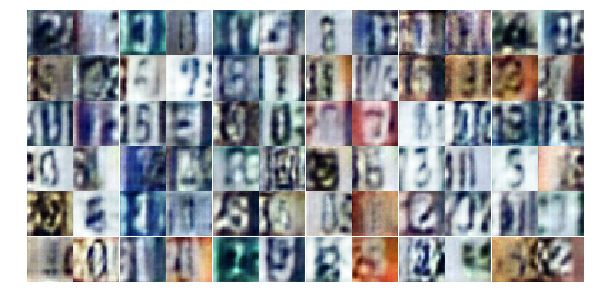

Epoch 6/25... Discriminator Loss: 0.8502... Generator Loss: 0.8344
Epoch 6/25... Discriminator Loss: 0.5913... Generator Loss: 1.2478
Epoch 6/25... Discriminator Loss: 1.3731... Generator Loss: 0.3791
Epoch 6/25... Discriminator Loss: 1.2548... Generator Loss: 0.4369
Epoch 6/25... Discriminator Loss: 1.1555... Generator Loss: 3.2996
Epoch 6/25... Discriminator Loss: 1.0076... Generator Loss: 1.1648
Epoch 6/25... Discriminator Loss: 0.7217... Generator Loss: 1.1969
Epoch 6/25... Discriminator Loss: 0.5446... Generator Loss: 1.2297
Epoch 6/25... Discriminator Loss: 0.5742... Generator Loss: 1.3182
Epoch 6/25... Discriminator Loss: 0.3930... Generator Loss: 1.7488


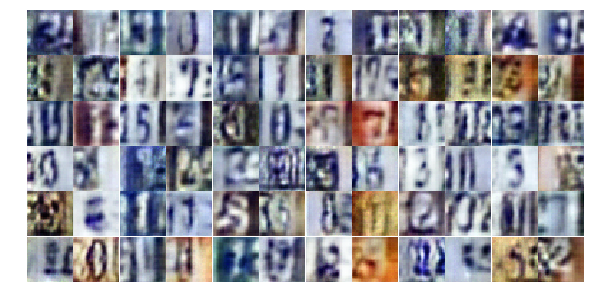

Epoch 6/25... Discriminator Loss: 0.9248... Generator Loss: 0.6712
Epoch 6/25... Discriminator Loss: 0.4659... Generator Loss: 2.0165
Epoch 6/25... Discriminator Loss: 0.6452... Generator Loss: 1.0270
Epoch 6/25... Discriminator Loss: 0.4447... Generator Loss: 1.8546
Epoch 6/25... Discriminator Loss: 0.7278... Generator Loss: 1.1393
Epoch 6/25... Discriminator Loss: 0.7108... Generator Loss: 1.1390
Epoch 6/25... Discriminator Loss: 0.8035... Generator Loss: 0.8169
Epoch 6/25... Discriminator Loss: 1.0623... Generator Loss: 0.5885
Epoch 6/25... Discriminator Loss: 0.7209... Generator Loss: 1.9229
Epoch 6/25... Discriminator Loss: 0.5233... Generator Loss: 1.1855


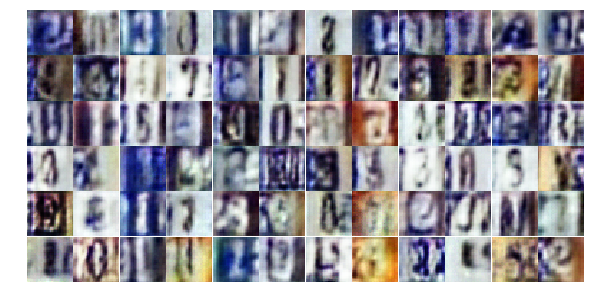

Epoch 6/25... Discriminator Loss: 1.0045... Generator Loss: 2.2780
Epoch 6/25... Discriminator Loss: 1.6890... Generator Loss: 0.2763
Epoch 6/25... Discriminator Loss: 1.0647... Generator Loss: 0.9805
Epoch 6/25... Discriminator Loss: 0.6129... Generator Loss: 1.8144
Epoch 6/25... Discriminator Loss: 0.5717... Generator Loss: 1.3624
Epoch 6/25... Discriminator Loss: 0.6260... Generator Loss: 1.3723
Epoch 6/25... Discriminator Loss: 0.8019... Generator Loss: 0.9032
Epoch 6/25... Discriminator Loss: 1.4306... Generator Loss: 0.3736
Epoch 6/25... Discriminator Loss: 0.6026... Generator Loss: 1.0907
Epoch 6/25... Discriminator Loss: 1.7411... Generator Loss: 0.2819


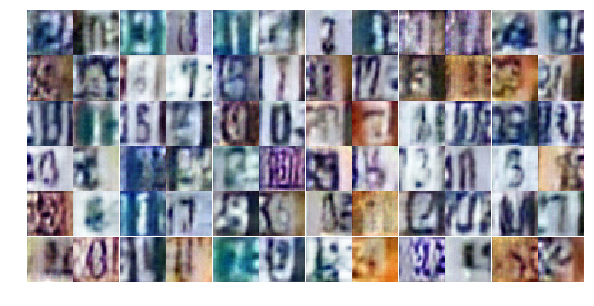

Epoch 6/25... Discriminator Loss: 0.7760... Generator Loss: 0.9412
Epoch 6/25... Discriminator Loss: 0.4685... Generator Loss: 1.4152
Epoch 6/25... Discriminator Loss: 1.3356... Generator Loss: 0.5701
Epoch 7/25... Discriminator Loss: 0.5210... Generator Loss: 1.7017
Epoch 7/25... Discriminator Loss: 0.4617... Generator Loss: 1.7478
Epoch 7/25... Discriminator Loss: 0.7291... Generator Loss: 1.0344
Epoch 7/25... Discriminator Loss: 0.3836... Generator Loss: 1.5976
Epoch 7/25... Discriminator Loss: 1.1532... Generator Loss: 0.5447
Epoch 7/25... Discriminator Loss: 0.5594... Generator Loss: 2.4001
Epoch 7/25... Discriminator Loss: 0.7964... Generator Loss: 1.6356


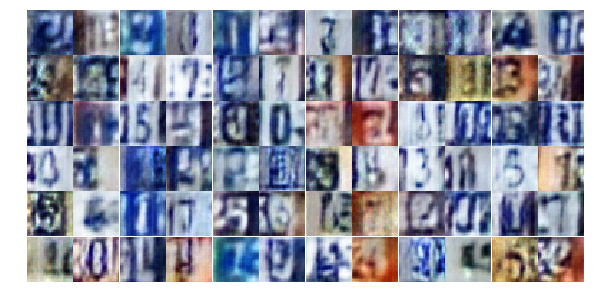

Epoch 7/25... Discriminator Loss: 1.3405... Generator Loss: 3.2397
Epoch 7/25... Discriminator Loss: 0.9281... Generator Loss: 0.7218
Epoch 7/25... Discriminator Loss: 0.7236... Generator Loss: 0.9291
Epoch 7/25... Discriminator Loss: 0.6838... Generator Loss: 1.0893
Epoch 7/25... Discriminator Loss: 0.4781... Generator Loss: 1.5831
Epoch 7/25... Discriminator Loss: 0.6311... Generator Loss: 1.1131
Epoch 7/25... Discriminator Loss: 0.7844... Generator Loss: 1.1043
Epoch 7/25... Discriminator Loss: 1.8822... Generator Loss: 3.2512
Epoch 7/25... Discriminator Loss: 1.4555... Generator Loss: 3.3977
Epoch 7/25... Discriminator Loss: 0.5760... Generator Loss: 1.1494


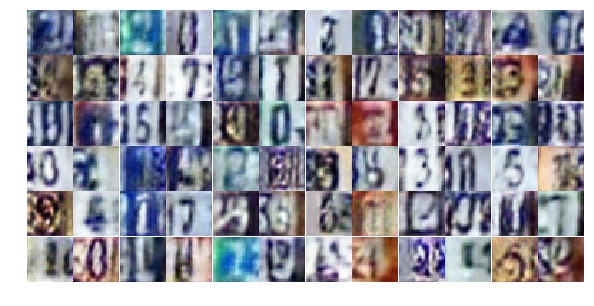

Epoch 7/25... Discriminator Loss: 0.5255... Generator Loss: 1.7936
Epoch 7/25... Discriminator Loss: 0.3825... Generator Loss: 1.9266
Epoch 7/25... Discriminator Loss: 0.8980... Generator Loss: 0.7238
Epoch 7/25... Discriminator Loss: 0.4927... Generator Loss: 1.4802
Epoch 7/25... Discriminator Loss: 0.4896... Generator Loss: 1.6271
Epoch 7/25... Discriminator Loss: 0.4713... Generator Loss: 1.5963
Epoch 7/25... Discriminator Loss: 0.5906... Generator Loss: 1.7169
Epoch 7/25... Discriminator Loss: 1.4951... Generator Loss: 0.3444
Epoch 7/25... Discriminator Loss: 0.6491... Generator Loss: 1.5611
Epoch 7/25... Discriminator Loss: 0.4956... Generator Loss: 1.5076


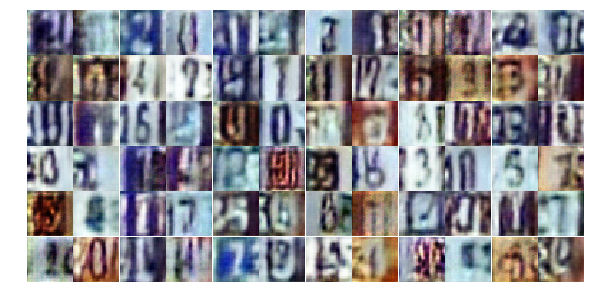

Epoch 7/25... Discriminator Loss: 0.9608... Generator Loss: 0.6505
Epoch 7/25... Discriminator Loss: 0.5231... Generator Loss: 1.2887
Epoch 7/25... Discriminator Loss: 0.3473... Generator Loss: 2.0547
Epoch 7/25... Discriminator Loss: 0.7290... Generator Loss: 1.3347
Epoch 7/25... Discriminator Loss: 0.7803... Generator Loss: 2.1833
Epoch 7/25... Discriminator Loss: 1.0685... Generator Loss: 0.5924
Epoch 7/25... Discriminator Loss: 0.6196... Generator Loss: 1.0535
Epoch 7/25... Discriminator Loss: 1.3020... Generator Loss: 0.4617
Epoch 7/25... Discriminator Loss: 1.3029... Generator Loss: 0.4151
Epoch 7/25... Discriminator Loss: 0.4945... Generator Loss: 1.9345


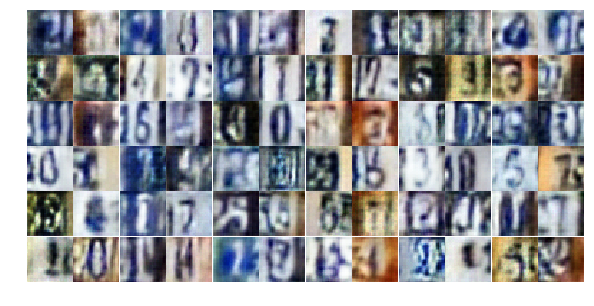

Epoch 7/25... Discriminator Loss: 0.7819... Generator Loss: 1.8020
Epoch 7/25... Discriminator Loss: 0.7396... Generator Loss: 2.7421
Epoch 7/25... Discriminator Loss: 0.6351... Generator Loss: 1.8502
Epoch 7/25... Discriminator Loss: 0.7254... Generator Loss: 1.0599
Epoch 7/25... Discriminator Loss: 0.7385... Generator Loss: 0.9460
Epoch 7/25... Discriminator Loss: 0.4549... Generator Loss: 1.7755
Epoch 7/25... Discriminator Loss: 0.6099... Generator Loss: 1.1359
Epoch 7/25... Discriminator Loss: 0.7248... Generator Loss: 1.7611
Epoch 7/25... Discriminator Loss: 0.3656... Generator Loss: 3.0643
Epoch 7/25... Discriminator Loss: 0.9386... Generator Loss: 0.7682


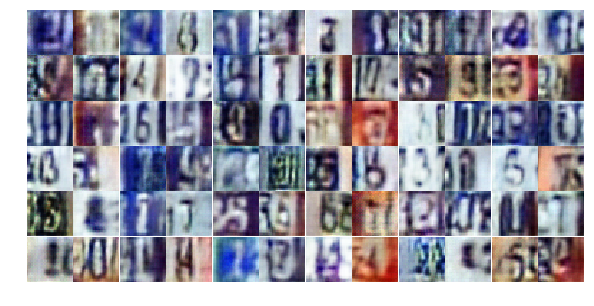

Epoch 7/25... Discriminator Loss: 0.4511... Generator Loss: 1.9256
Epoch 7/25... Discriminator Loss: 0.7261... Generator Loss: 0.9973
Epoch 7/25... Discriminator Loss: 0.7262... Generator Loss: 0.9397
Epoch 7/25... Discriminator Loss: 0.7686... Generator Loss: 0.9884
Epoch 7/25... Discriminator Loss: 0.5108... Generator Loss: 1.1918
Epoch 7/25... Discriminator Loss: 0.4587... Generator Loss: 1.6766
Epoch 7/25... Discriminator Loss: 1.6730... Generator Loss: 0.2606
Epoch 7/25... Discriminator Loss: 0.8944... Generator Loss: 0.7239
Epoch 7/25... Discriminator Loss: 1.1884... Generator Loss: 0.5783
Epoch 7/25... Discriminator Loss: 2.0385... Generator Loss: 0.2266


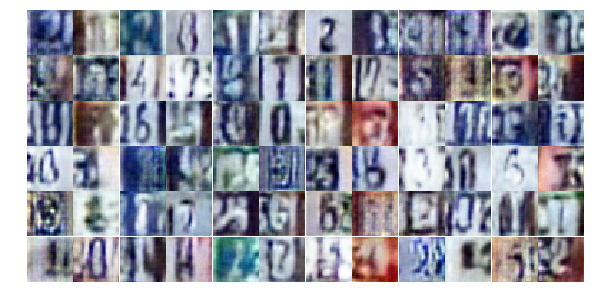

Epoch 7/25... Discriminator Loss: 0.6749... Generator Loss: 1.4684
Epoch 8/25... Discriminator Loss: 0.6494... Generator Loss: 1.1816
Epoch 8/25... Discriminator Loss: 0.7220... Generator Loss: 0.9504
Epoch 8/25... Discriminator Loss: 0.5565... Generator Loss: 1.3712
Epoch 8/25... Discriminator Loss: 0.7403... Generator Loss: 0.9788
Epoch 8/25... Discriminator Loss: 0.8542... Generator Loss: 0.7763
Epoch 8/25... Discriminator Loss: 0.5056... Generator Loss: 1.3466
Epoch 8/25... Discriminator Loss: 0.6247... Generator Loss: 1.3507
Epoch 8/25... Discriminator Loss: 0.7789... Generator Loss: 0.8569
Epoch 8/25... Discriminator Loss: 0.6785... Generator Loss: 1.1182


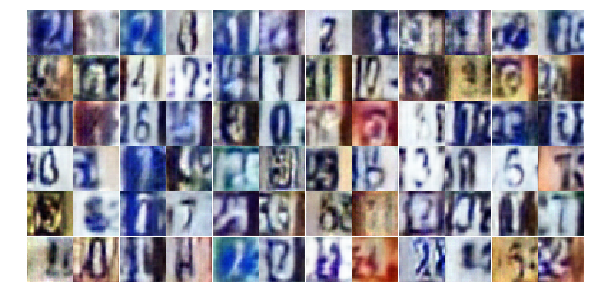

Epoch 8/25... Discriminator Loss: 0.5234... Generator Loss: 1.4191
Epoch 8/25... Discriminator Loss: 0.4858... Generator Loss: 1.8352
Epoch 8/25... Discriminator Loss: 1.0703... Generator Loss: 0.5358
Epoch 8/25... Discriminator Loss: 0.4249... Generator Loss: 2.0572
Epoch 8/25... Discriminator Loss: 0.8494... Generator Loss: 0.8544
Epoch 8/25... Discriminator Loss: 0.5542... Generator Loss: 1.9125
Epoch 8/25... Discriminator Loss: 0.4407... Generator Loss: 1.6256
Epoch 8/25... Discriminator Loss: 0.3538... Generator Loss: 1.6299
Epoch 8/25... Discriminator Loss: 0.7785... Generator Loss: 1.1597
Epoch 8/25... Discriminator Loss: 1.0740... Generator Loss: 0.5868


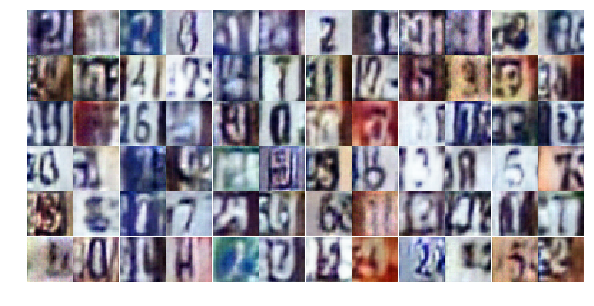

Epoch 8/25... Discriminator Loss: 0.5691... Generator Loss: 1.1528
Epoch 8/25... Discriminator Loss: 0.7750... Generator Loss: 0.8521
Epoch 8/25... Discriminator Loss: 0.6373... Generator Loss: 1.5921
Epoch 8/25... Discriminator Loss: 0.6456... Generator Loss: 1.2360
Epoch 8/25... Discriminator Loss: 0.3194... Generator Loss: 2.1310
Epoch 8/25... Discriminator Loss: 0.6271... Generator Loss: 0.9813
Epoch 8/25... Discriminator Loss: 0.9022... Generator Loss: 2.8618
Epoch 8/25... Discriminator Loss: 0.4556... Generator Loss: 1.7513
Epoch 8/25... Discriminator Loss: 1.3808... Generator Loss: 3.3386
Epoch 8/25... Discriminator Loss: 1.2128... Generator Loss: 0.4914


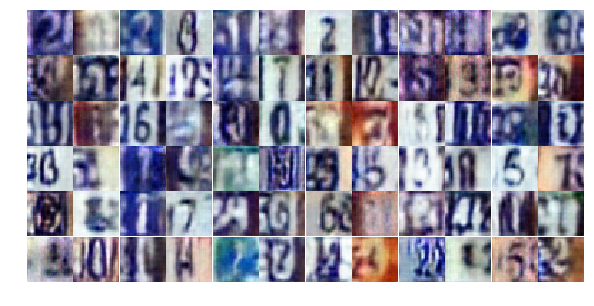

Epoch 8/25... Discriminator Loss: 0.8588... Generator Loss: 1.8362
Epoch 8/25... Discriminator Loss: 0.9789... Generator Loss: 0.6257
Epoch 8/25... Discriminator Loss: 0.6019... Generator Loss: 1.1978
Epoch 8/25... Discriminator Loss: 1.4721... Generator Loss: 0.3444
Epoch 8/25... Discriminator Loss: 0.5824... Generator Loss: 1.2123
Epoch 8/25... Discriminator Loss: 0.6684... Generator Loss: 0.9767
Epoch 8/25... Discriminator Loss: 0.4647... Generator Loss: 1.4914
Epoch 8/25... Discriminator Loss: 0.6882... Generator Loss: 0.9589
Epoch 8/25... Discriminator Loss: 0.5351... Generator Loss: 1.4496
Epoch 8/25... Discriminator Loss: 0.4312... Generator Loss: 1.6673


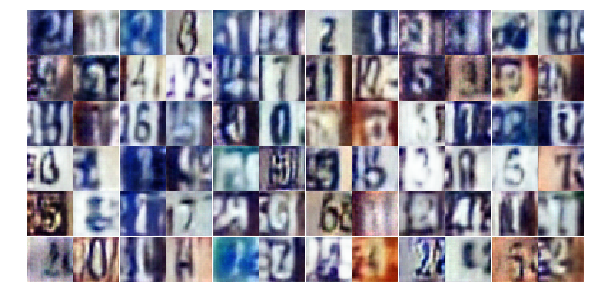

Epoch 8/25... Discriminator Loss: 0.4161... Generator Loss: 1.4897
Epoch 8/25... Discriminator Loss: 0.8461... Generator Loss: 0.8580
Epoch 8/25... Discriminator Loss: 0.8770... Generator Loss: 0.7753
Epoch 8/25... Discriminator Loss: 0.3809... Generator Loss: 1.7562
Epoch 8/25... Discriminator Loss: 1.4959... Generator Loss: 2.7926
Epoch 8/25... Discriminator Loss: 1.5655... Generator Loss: 0.7708
Epoch 8/25... Discriminator Loss: 0.5595... Generator Loss: 2.3006
Epoch 8/25... Discriminator Loss: 0.7234... Generator Loss: 1.8388
Epoch 8/25... Discriminator Loss: 0.8105... Generator Loss: 1.0435
Epoch 8/25... Discriminator Loss: 0.6588... Generator Loss: 1.2119


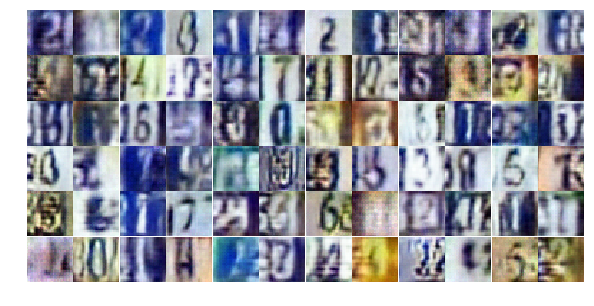

Epoch 8/25... Discriminator Loss: 0.4931... Generator Loss: 1.8522
Epoch 8/25... Discriminator Loss: 0.4809... Generator Loss: 1.7500
Epoch 8/25... Discriminator Loss: 0.6180... Generator Loss: 3.3738
Epoch 8/25... Discriminator Loss: 1.3919... Generator Loss: 0.4233
Epoch 8/25... Discriminator Loss: 0.4513... Generator Loss: 2.2522
Epoch 8/25... Discriminator Loss: 1.1685... Generator Loss: 0.5379
Epoch 8/25... Discriminator Loss: 0.6131... Generator Loss: 1.1009
Epoch 8/25... Discriminator Loss: 0.6359... Generator Loss: 1.7263
Epoch 9/25... Discriminator Loss: 1.0550... Generator Loss: 0.7170
Epoch 9/25... Discriminator Loss: 0.6512... Generator Loss: 0.9944


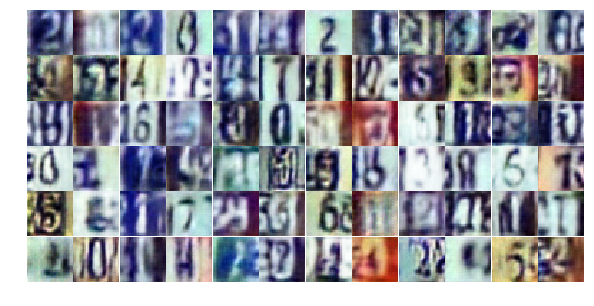

Epoch 9/25... Discriminator Loss: 0.4531... Generator Loss: 1.5251
Epoch 9/25... Discriminator Loss: 0.4834... Generator Loss: 1.7595
Epoch 9/25... Discriminator Loss: 0.9471... Generator Loss: 0.8461
Epoch 9/25... Discriminator Loss: 0.8528... Generator Loss: 0.7968
Epoch 9/25... Discriminator Loss: 1.5020... Generator Loss: 0.3714
Epoch 9/25... Discriminator Loss: 0.6954... Generator Loss: 1.3185
Epoch 9/25... Discriminator Loss: 0.6191... Generator Loss: 1.3096
Epoch 9/25... Discriminator Loss: 0.5224... Generator Loss: 1.3204
Epoch 9/25... Discriminator Loss: 0.9179... Generator Loss: 0.7033
Epoch 9/25... Discriminator Loss: 0.6869... Generator Loss: 0.9574


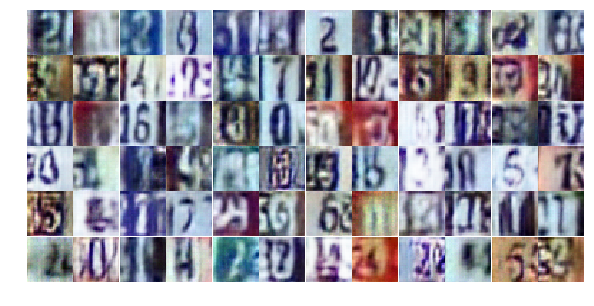

Epoch 9/25... Discriminator Loss: 0.9048... Generator Loss: 0.6783
Epoch 9/25... Discriminator Loss: 0.9804... Generator Loss: 0.6534
Epoch 9/25... Discriminator Loss: 0.6546... Generator Loss: 1.7413
Epoch 9/25... Discriminator Loss: 0.7270... Generator Loss: 0.9847
Epoch 9/25... Discriminator Loss: 0.6066... Generator Loss: 1.1230
Epoch 9/25... Discriminator Loss: 0.8027... Generator Loss: 1.0049
Epoch 9/25... Discriminator Loss: 0.7525... Generator Loss: 0.9007
Epoch 9/25... Discriminator Loss: 0.5464... Generator Loss: 1.2468
Epoch 9/25... Discriminator Loss: 1.0878... Generator Loss: 0.5647
Epoch 9/25... Discriminator Loss: 0.7852... Generator Loss: 0.8089


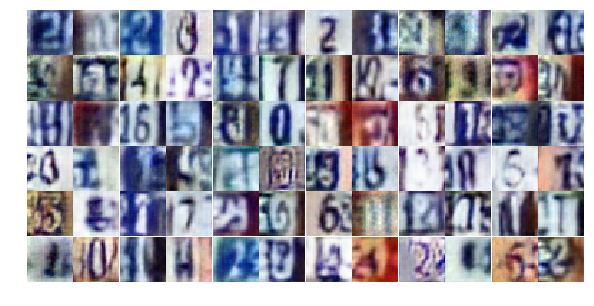

Epoch 9/25... Discriminator Loss: 1.1148... Generator Loss: 0.6274
Epoch 9/25... Discriminator Loss: 0.5380... Generator Loss: 1.4433
Epoch 9/25... Discriminator Loss: 0.5080... Generator Loss: 2.8697
Epoch 9/25... Discriminator Loss: 0.8805... Generator Loss: 0.8276
Epoch 9/25... Discriminator Loss: 0.5505... Generator Loss: 1.1882
Epoch 9/25... Discriminator Loss: 0.5319... Generator Loss: 1.2132
Epoch 9/25... Discriminator Loss: 1.2392... Generator Loss: 0.5521
Epoch 9/25... Discriminator Loss: 0.5231... Generator Loss: 1.5088
Epoch 9/25... Discriminator Loss: 0.5700... Generator Loss: 1.5033
Epoch 9/25... Discriminator Loss: 0.4918... Generator Loss: 1.2714


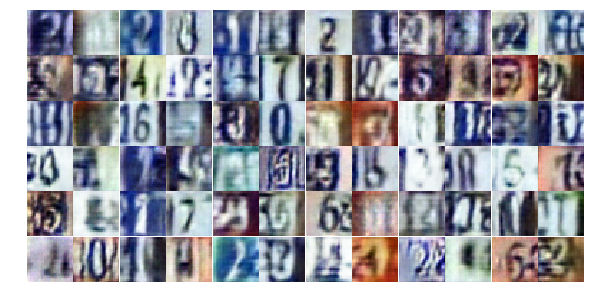

Epoch 9/25... Discriminator Loss: 0.5153... Generator Loss: 1.2596
Epoch 9/25... Discriminator Loss: 0.7870... Generator Loss: 0.7969
Epoch 9/25... Discriminator Loss: 0.6843... Generator Loss: 1.1023
Epoch 9/25... Discriminator Loss: 0.6160... Generator Loss: 1.1841
Epoch 9/25... Discriminator Loss: 0.7422... Generator Loss: 0.9467
Epoch 9/25... Discriminator Loss: 0.7603... Generator Loss: 1.2317
Epoch 9/25... Discriminator Loss: 0.4861... Generator Loss: 1.4051
Epoch 9/25... Discriminator Loss: 0.3935... Generator Loss: 1.4695
Epoch 9/25... Discriminator Loss: 1.1167... Generator Loss: 0.5645
Epoch 9/25... Discriminator Loss: 0.7533... Generator Loss: 0.8753


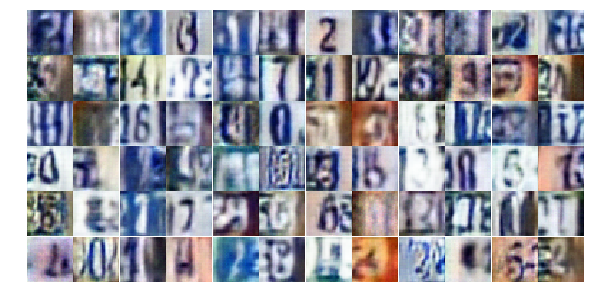

Epoch 9/25... Discriminator Loss: 0.5189... Generator Loss: 3.3178
Epoch 9/25... Discriminator Loss: 0.5325... Generator Loss: 1.1687
Epoch 9/25... Discriminator Loss: 1.2337... Generator Loss: 3.2412
Epoch 9/25... Discriminator Loss: 0.7237... Generator Loss: 1.2621
Epoch 9/25... Discriminator Loss: 0.4560... Generator Loss: 1.7237
Epoch 9/25... Discriminator Loss: 0.7361... Generator Loss: 0.9043
Epoch 9/25... Discriminator Loss: 0.6287... Generator Loss: 1.3506
Epoch 9/25... Discriminator Loss: 0.8765... Generator Loss: 0.7644
Epoch 9/25... Discriminator Loss: 0.6083... Generator Loss: 1.1901
Epoch 9/25... Discriminator Loss: 0.4916... Generator Loss: 1.7512


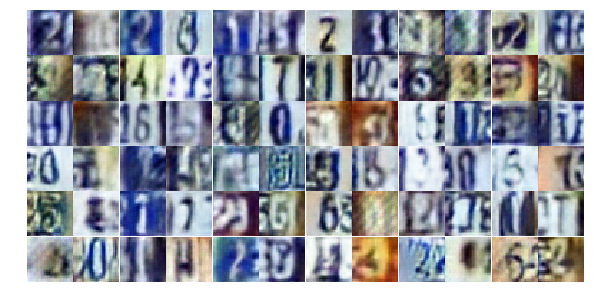

Epoch 9/25... Discriminator Loss: 0.7905... Generator Loss: 1.1647
Epoch 9/25... Discriminator Loss: 0.7517... Generator Loss: 3.2296
Epoch 9/25... Discriminator Loss: 0.6092... Generator Loss: 1.4204
Epoch 9/25... Discriminator Loss: 1.0237... Generator Loss: 0.6110
Epoch 9/25... Discriminator Loss: 0.8274... Generator Loss: 2.0953
Epoch 10/25... Discriminator Loss: 0.8440... Generator Loss: 0.8479
Epoch 10/25... Discriminator Loss: 0.6595... Generator Loss: 1.1507
Epoch 10/25... Discriminator Loss: 0.5047... Generator Loss: 1.3539
Epoch 10/25... Discriminator Loss: 0.7736... Generator Loss: 1.1904
Epoch 10/25... Discriminator Loss: 1.0079... Generator Loss: 0.6278


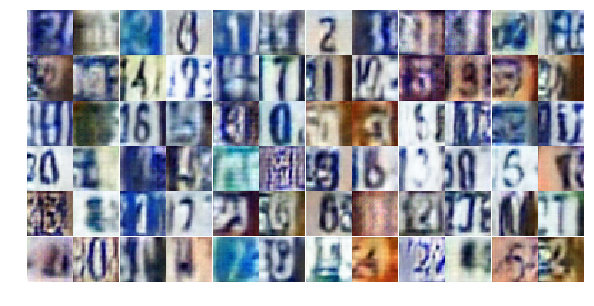

Epoch 10/25... Discriminator Loss: 0.6128... Generator Loss: 1.1460
Epoch 10/25... Discriminator Loss: 0.4956... Generator Loss: 1.4397
Epoch 10/25... Discriminator Loss: 0.5002... Generator Loss: 1.4796
Epoch 10/25... Discriminator Loss: 0.6788... Generator Loss: 1.4898
Epoch 10/25... Discriminator Loss: 0.5176... Generator Loss: 1.4091
Epoch 10/25... Discriminator Loss: 0.6202... Generator Loss: 1.4682
Epoch 10/25... Discriminator Loss: 0.6385... Generator Loss: 1.0537
Epoch 10/25... Discriminator Loss: 0.6402... Generator Loss: 1.1172
Epoch 10/25... Discriminator Loss: 0.6138... Generator Loss: 1.1887
Epoch 10/25... Discriminator Loss: 0.5585... Generator Loss: 1.9085


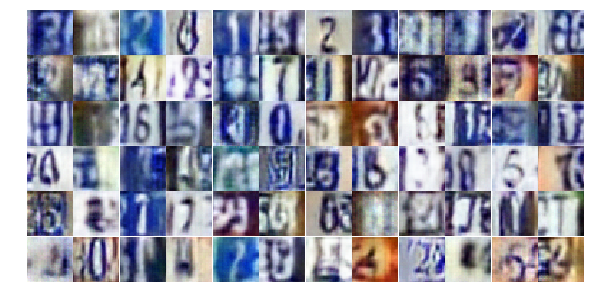

Epoch 10/25... Discriminator Loss: 0.7217... Generator Loss: 1.0746
Epoch 10/25... Discriminator Loss: 0.9707... Generator Loss: 0.6784
Epoch 10/25... Discriminator Loss: 0.5734... Generator Loss: 1.2073
Epoch 10/25... Discriminator Loss: 1.6221... Generator Loss: 0.3203
Epoch 10/25... Discriminator Loss: 0.4036... Generator Loss: 1.6898
Epoch 10/25... Discriminator Loss: 0.8415... Generator Loss: 0.7798
Epoch 10/25... Discriminator Loss: 0.5899... Generator Loss: 1.1344
Epoch 10/25... Discriminator Loss: 0.5632... Generator Loss: 1.1679
Epoch 10/25... Discriminator Loss: 0.5548... Generator Loss: 1.2579
Epoch 10/25... Discriminator Loss: 0.4384... Generator Loss: 2.8720


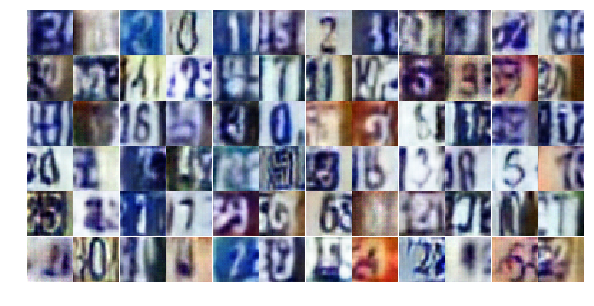

Epoch 10/25... Discriminator Loss: 0.7455... Generator Loss: 0.9062
Epoch 10/25... Discriminator Loss: 0.4769... Generator Loss: 1.5862
Epoch 10/25... Discriminator Loss: 1.3163... Generator Loss: 3.3601
Epoch 10/25... Discriminator Loss: 1.3278... Generator Loss: 1.3355
Epoch 10/25... Discriminator Loss: 1.3802... Generator Loss: 0.4430
Epoch 10/25... Discriminator Loss: 0.7079... Generator Loss: 1.1688
Epoch 10/25... Discriminator Loss: 0.3985... Generator Loss: 1.8767
Epoch 10/25... Discriminator Loss: 1.0165... Generator Loss: 0.6408
Epoch 10/25... Discriminator Loss: 0.6364... Generator Loss: 1.0586
Epoch 10/25... Discriminator Loss: 0.9343... Generator Loss: 0.7755


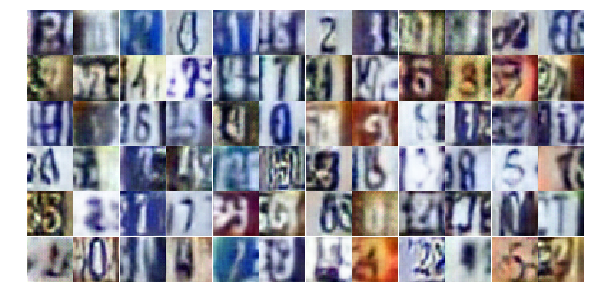

Epoch 10/25... Discriminator Loss: 0.7310... Generator Loss: 1.0095
Epoch 10/25... Discriminator Loss: 0.5291... Generator Loss: 1.3564
Epoch 10/25... Discriminator Loss: 0.5207... Generator Loss: 1.5059
Epoch 10/25... Discriminator Loss: 0.6141... Generator Loss: 1.0988
Epoch 10/25... Discriminator Loss: 0.6712... Generator Loss: 1.1044
Epoch 10/25... Discriminator Loss: 0.6593... Generator Loss: 0.9702
Epoch 10/25... Discriminator Loss: 0.6103... Generator Loss: 1.0647
Epoch 10/25... Discriminator Loss: 0.6767... Generator Loss: 0.9101
Epoch 10/25... Discriminator Loss: 0.6412... Generator Loss: 0.9482
Epoch 10/25... Discriminator Loss: 0.7085... Generator Loss: 0.9864


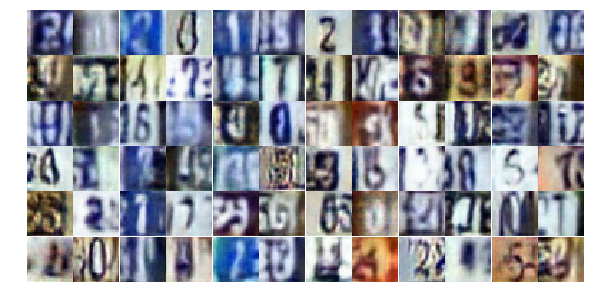

Epoch 10/25... Discriminator Loss: 0.5789... Generator Loss: 1.1698
Epoch 10/25... Discriminator Loss: 0.7256... Generator Loss: 0.9752
Epoch 10/25... Discriminator Loss: 0.7131... Generator Loss: 1.0500
Epoch 10/25... Discriminator Loss: 0.6820... Generator Loss: 1.2031
Epoch 10/25... Discriminator Loss: 0.4449... Generator Loss: 1.7484
Epoch 10/25... Discriminator Loss: 0.4373... Generator Loss: 1.4957
Epoch 10/25... Discriminator Loss: 0.5285... Generator Loss: 1.2210
Epoch 10/25... Discriminator Loss: 0.7100... Generator Loss: 1.6198
Epoch 10/25... Discriminator Loss: 0.4896... Generator Loss: 1.9027
Epoch 10/25... Discriminator Loss: 0.5316... Generator Loss: 1.4734


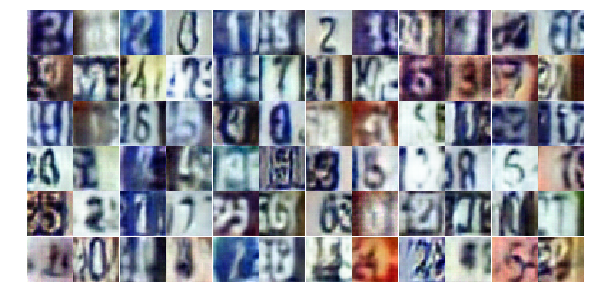

Epoch 10/25... Discriminator Loss: 0.9062... Generator Loss: 1.1463
Epoch 10/25... Discriminator Loss: 0.5613... Generator Loss: 1.1651
Epoch 10/25... Discriminator Loss: 0.4917... Generator Loss: 1.3255
Epoch 11/25... Discriminator Loss: 0.9431... Generator Loss: 0.6696
Epoch 11/25... Discriminator Loss: 0.7303... Generator Loss: 0.8947
Epoch 11/25... Discriminator Loss: 1.6280... Generator Loss: 0.2865
Epoch 11/25... Discriminator Loss: 0.6321... Generator Loss: 1.4121
Epoch 11/25... Discriminator Loss: 0.6710... Generator Loss: 1.1311
Epoch 11/25... Discriminator Loss: 1.6626... Generator Loss: 0.3371
Epoch 11/25... Discriminator Loss: 0.5926... Generator Loss: 1.5409


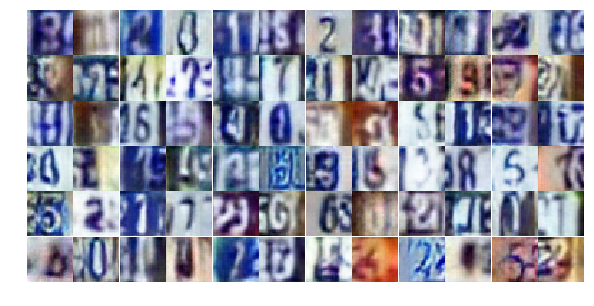

Epoch 11/25... Discriminator Loss: 0.4391... Generator Loss: 1.7055
Epoch 11/25... Discriminator Loss: 0.8209... Generator Loss: 0.7795
Epoch 11/25... Discriminator Loss: 0.4578... Generator Loss: 1.4943
Epoch 11/25... Discriminator Loss: 0.5438... Generator Loss: 1.3270
Epoch 11/25... Discriminator Loss: 0.5984... Generator Loss: 1.2293
Epoch 11/25... Discriminator Loss: 0.2920... Generator Loss: 2.0879
Epoch 11/25... Discriminator Loss: 1.3758... Generator Loss: 2.2063
Epoch 11/25... Discriminator Loss: 0.5501... Generator Loss: 1.4791
Epoch 11/25... Discriminator Loss: 0.9388... Generator Loss: 0.6755
Epoch 11/25... Discriminator Loss: 0.9689... Generator Loss: 0.6754


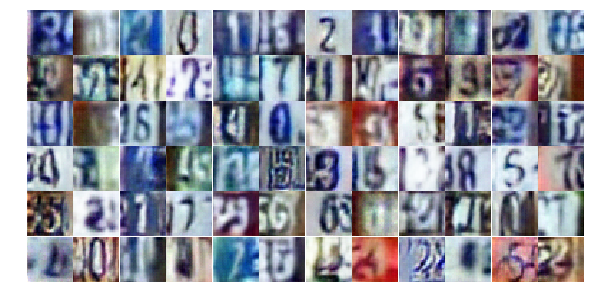

Epoch 11/25... Discriminator Loss: 1.0613... Generator Loss: 0.6038
Epoch 11/25... Discriminator Loss: 0.5065... Generator Loss: 1.5411
Epoch 11/25... Discriminator Loss: 0.8605... Generator Loss: 0.7738
Epoch 11/25... Discriminator Loss: 0.5970... Generator Loss: 1.1386
Epoch 11/25... Discriminator Loss: 0.5832... Generator Loss: 2.6854
Epoch 11/25... Discriminator Loss: 0.3668... Generator Loss: 1.5773
Epoch 11/25... Discriminator Loss: 0.5506... Generator Loss: 1.1812
Epoch 11/25... Discriminator Loss: 0.6659... Generator Loss: 1.1053
Epoch 11/25... Discriminator Loss: 0.3162... Generator Loss: 1.9659
Epoch 11/25... Discriminator Loss: 0.6234... Generator Loss: 1.0702


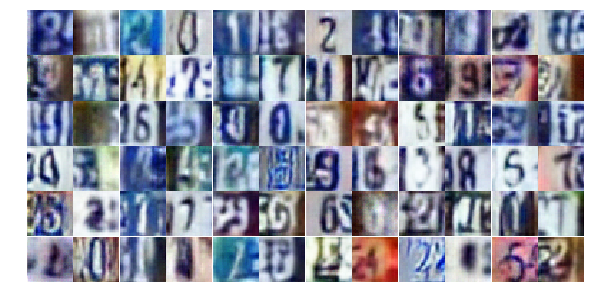

Epoch 11/25... Discriminator Loss: 0.7496... Generator Loss: 0.8416
Epoch 11/25... Discriminator Loss: 0.7845... Generator Loss: 1.5743
Epoch 11/25... Discriminator Loss: 0.7051... Generator Loss: 1.0155
Epoch 11/25... Discriminator Loss: 0.5079... Generator Loss: 1.3342
Epoch 11/25... Discriminator Loss: 0.5911... Generator Loss: 1.1514
Epoch 11/25... Discriminator Loss: 0.6773... Generator Loss: 1.1369
Epoch 11/25... Discriminator Loss: 0.7351... Generator Loss: 1.2221
Epoch 11/25... Discriminator Loss: 0.8489... Generator Loss: 0.7449
Epoch 11/25... Discriminator Loss: 0.4856... Generator Loss: 1.2975
Epoch 11/25... Discriminator Loss: 1.0796... Generator Loss: 0.5801


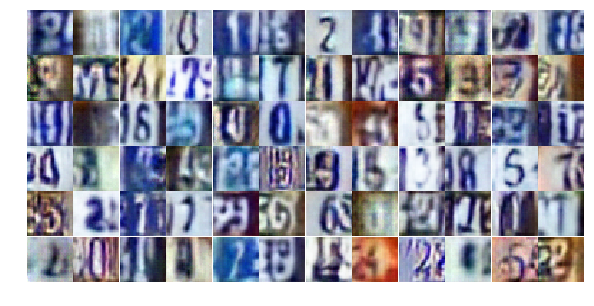

Epoch 11/25... Discriminator Loss: 0.3774... Generator Loss: 1.6505
Epoch 11/25... Discriminator Loss: 0.5319... Generator Loss: 1.4278
Epoch 11/25... Discriminator Loss: 0.6142... Generator Loss: 1.0971
Epoch 11/25... Discriminator Loss: 0.8738... Generator Loss: 0.7312
Epoch 11/25... Discriminator Loss: 0.6750... Generator Loss: 0.9799
Epoch 11/25... Discriminator Loss: 0.9734... Generator Loss: 0.6899
Epoch 11/25... Discriminator Loss: 0.2692... Generator Loss: 2.4191
Epoch 11/25... Discriminator Loss: 0.5327... Generator Loss: 1.5539
Epoch 11/25... Discriminator Loss: 1.0573... Generator Loss: 1.7472
Epoch 11/25... Discriminator Loss: 0.4809... Generator Loss: 1.4030


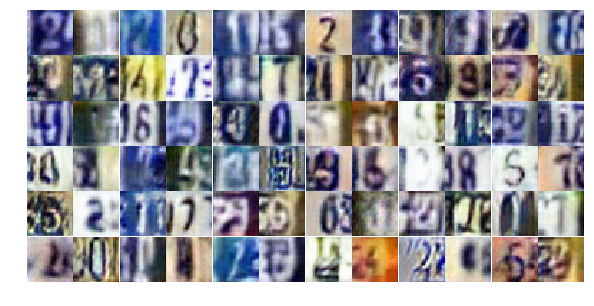

Epoch 11/25... Discriminator Loss: 0.5792... Generator Loss: 1.4078
Epoch 11/25... Discriminator Loss: 0.3810... Generator Loss: 1.7951
Epoch 11/25... Discriminator Loss: 0.6349... Generator Loss: 2.2989
Epoch 11/25... Discriminator Loss: 0.6386... Generator Loss: 0.9900
Epoch 11/25... Discriminator Loss: 0.7647... Generator Loss: 1.4111
Epoch 11/25... Discriminator Loss: 2.2746... Generator Loss: 0.1735
Epoch 11/25... Discriminator Loss: 0.5643... Generator Loss: 1.7437
Epoch 11/25... Discriminator Loss: 0.4348... Generator Loss: 2.0905
Epoch 11/25... Discriminator Loss: 1.1854... Generator Loss: 0.5738
Epoch 11/25... Discriminator Loss: 0.7949... Generator Loss: 0.9287


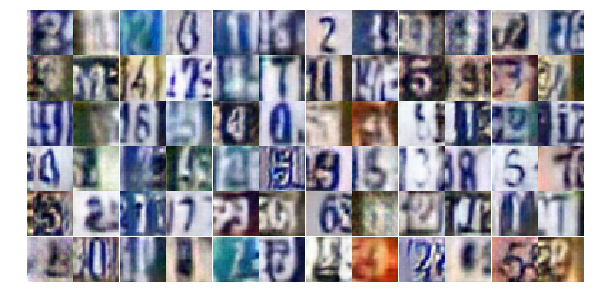

Epoch 12/25... Discriminator Loss: 0.8461... Generator Loss: 0.9855
Epoch 12/25... Discriminator Loss: 0.6475... Generator Loss: 1.2641
Epoch 12/25... Discriminator Loss: 0.7426... Generator Loss: 0.9809
Epoch 12/25... Discriminator Loss: 0.4594... Generator Loss: 1.5765
Epoch 12/25... Discriminator Loss: 0.3727... Generator Loss: 1.6079
Epoch 12/25... Discriminator Loss: 0.7456... Generator Loss: 0.9271
Epoch 12/25... Discriminator Loss: 0.9830... Generator Loss: 2.7714
Epoch 12/25... Discriminator Loss: 0.9949... Generator Loss: 0.8787
Epoch 12/25... Discriminator Loss: 0.6642... Generator Loss: 1.1423
Epoch 12/25... Discriminator Loss: 0.9795... Generator Loss: 0.6532


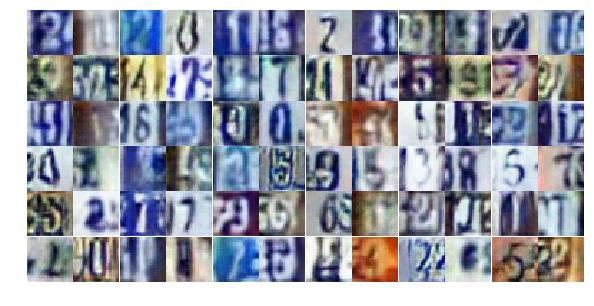

Epoch 12/25... Discriminator Loss: 0.5982... Generator Loss: 1.0752
Epoch 12/25... Discriminator Loss: 0.7146... Generator Loss: 0.9718
Epoch 12/25... Discriminator Loss: 0.4465... Generator Loss: 1.5012
Epoch 12/25... Discriminator Loss: 0.7244... Generator Loss: 1.8735
Epoch 12/25... Discriminator Loss: 0.5470... Generator Loss: 1.5000
Epoch 12/25... Discriminator Loss: 0.8132... Generator Loss: 0.8654
Epoch 12/25... Discriminator Loss: 1.4532... Generator Loss: 0.3589
Epoch 12/25... Discriminator Loss: 0.6715... Generator Loss: 1.2528
Epoch 12/25... Discriminator Loss: 0.5774... Generator Loss: 1.2028
Epoch 12/25... Discriminator Loss: 0.7533... Generator Loss: 0.8774


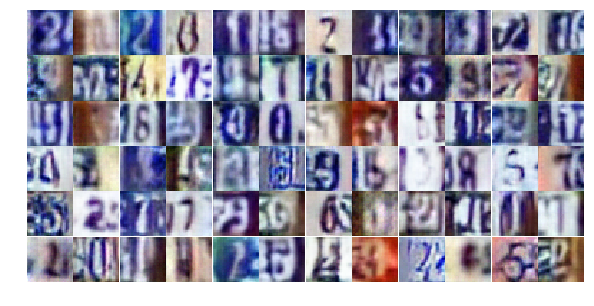

Epoch 12/25... Discriminator Loss: 0.4904... Generator Loss: 2.3539
Epoch 12/25... Discriminator Loss: 0.5677... Generator Loss: 1.6886
Epoch 12/25... Discriminator Loss: 0.5209... Generator Loss: 1.4920
Epoch 12/25... Discriminator Loss: 0.3975... Generator Loss: 1.6168
Epoch 12/25... Discriminator Loss: 0.3942... Generator Loss: 1.7619
Epoch 12/25... Discriminator Loss: 0.5242... Generator Loss: 1.2701
Epoch 12/25... Discriminator Loss: 0.5962... Generator Loss: 1.1865
Epoch 12/25... Discriminator Loss: 0.4331... Generator Loss: 1.4649
Epoch 12/25... Discriminator Loss: 0.6324... Generator Loss: 1.1062
Epoch 12/25... Discriminator Loss: 0.6094... Generator Loss: 1.0712


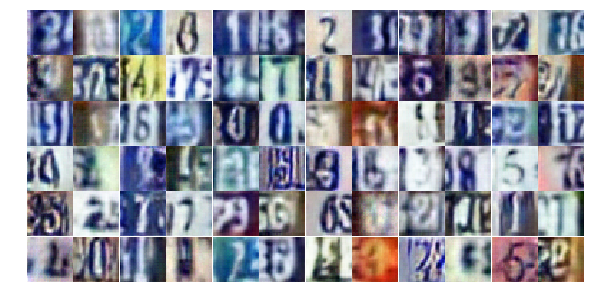

Epoch 12/25... Discriminator Loss: 0.4855... Generator Loss: 2.2630
Epoch 12/25... Discriminator Loss: 1.0487... Generator Loss: 0.6582
Epoch 12/25... Discriminator Loss: 0.7353... Generator Loss: 0.8388
Epoch 12/25... Discriminator Loss: 1.7773... Generator Loss: 0.2534
Epoch 12/25... Discriminator Loss: 0.5192... Generator Loss: 1.3566
Epoch 12/25... Discriminator Loss: 0.9413... Generator Loss: 0.8358
Epoch 12/25... Discriminator Loss: 1.3889... Generator Loss: 0.3741
Epoch 12/25... Discriminator Loss: 0.9539... Generator Loss: 0.7033
Epoch 12/25... Discriminator Loss: 0.4801... Generator Loss: 1.3581
Epoch 12/25... Discriminator Loss: 0.3912... Generator Loss: 1.7366


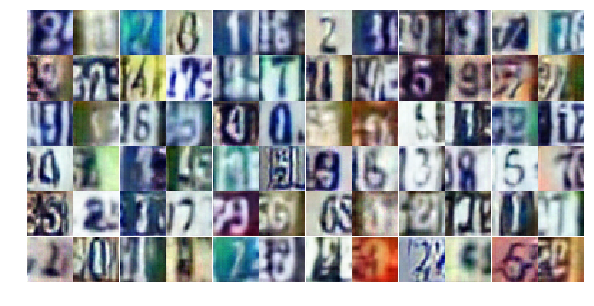

Epoch 12/25... Discriminator Loss: 0.6504... Generator Loss: 1.2236
Epoch 12/25... Discriminator Loss: 0.4193... Generator Loss: 1.4380
Epoch 12/25... Discriminator Loss: 0.4356... Generator Loss: 1.4664
Epoch 12/25... Discriminator Loss: 1.0831... Generator Loss: 0.6715
Epoch 12/25... Discriminator Loss: 1.2802... Generator Loss: 1.2845
Epoch 12/25... Discriminator Loss: 0.9668... Generator Loss: 0.7061
Epoch 12/25... Discriminator Loss: 0.9689... Generator Loss: 0.7978
Epoch 12/25... Discriminator Loss: 1.1818... Generator Loss: 0.5166
Epoch 12/25... Discriminator Loss: 0.6052... Generator Loss: 1.1561
Epoch 12/25... Discriminator Loss: 0.5811... Generator Loss: 1.3601


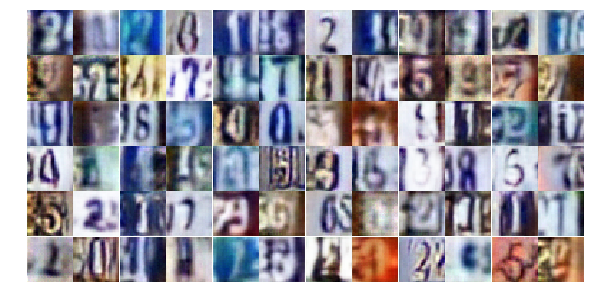

Epoch 12/25... Discriminator Loss: 1.3104... Generator Loss: 0.4317
Epoch 12/25... Discriminator Loss: 0.5577... Generator Loss: 1.2637
Epoch 12/25... Discriminator Loss: 0.6051... Generator Loss: 1.2304
Epoch 12/25... Discriminator Loss: 1.3900... Generator Loss: 0.4302
Epoch 12/25... Discriminator Loss: 0.5685... Generator Loss: 1.2713
Epoch 12/25... Discriminator Loss: 0.8173... Generator Loss: 1.5791
Epoch 12/25... Discriminator Loss: 0.7625... Generator Loss: 0.8533
Epoch 13/25... Discriminator Loss: 0.6495... Generator Loss: 1.0142
Epoch 13/25... Discriminator Loss: 0.4877... Generator Loss: 2.0047
Epoch 13/25... Discriminator Loss: 0.5666... Generator Loss: 1.4158


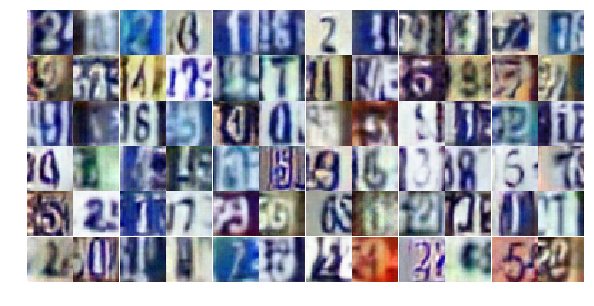

Epoch 13/25... Discriminator Loss: 0.9061... Generator Loss: 0.8456
Epoch 13/25... Discriminator Loss: 0.7211... Generator Loss: 1.8092
Epoch 13/25... Discriminator Loss: 1.4691... Generator Loss: 0.3448
Epoch 13/25... Discriminator Loss: 2.4469... Generator Loss: 0.1757
Epoch 13/25... Discriminator Loss: 0.9064... Generator Loss: 0.7619
Epoch 13/25... Discriminator Loss: 0.6380... Generator Loss: 1.0110
Epoch 13/25... Discriminator Loss: 0.4710... Generator Loss: 1.3393
Epoch 13/25... Discriminator Loss: 0.6763... Generator Loss: 0.9720
Epoch 13/25... Discriminator Loss: 0.6105... Generator Loss: 1.0715
Epoch 13/25... Discriminator Loss: 0.3531... Generator Loss: 1.6379


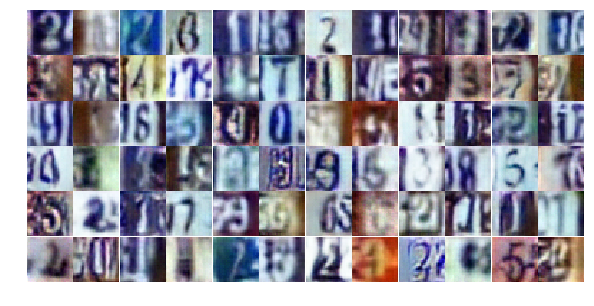

Epoch 13/25... Discriminator Loss: 0.9836... Generator Loss: 1.0457
Epoch 13/25... Discriminator Loss: 0.3821... Generator Loss: 1.8024
Epoch 13/25... Discriminator Loss: 1.0558... Generator Loss: 0.6498
Epoch 13/25... Discriminator Loss: 0.6989... Generator Loss: 0.9737
Epoch 13/25... Discriminator Loss: 0.5919... Generator Loss: 1.5322
Epoch 13/25... Discriminator Loss: 0.9298... Generator Loss: 1.7338
Epoch 13/25... Discriminator Loss: 0.6510... Generator Loss: 1.0178
Epoch 13/25... Discriminator Loss: 1.0733... Generator Loss: 0.6329
Epoch 13/25... Discriminator Loss: 0.5574... Generator Loss: 1.4806
Epoch 13/25... Discriminator Loss: 0.8870... Generator Loss: 0.6699


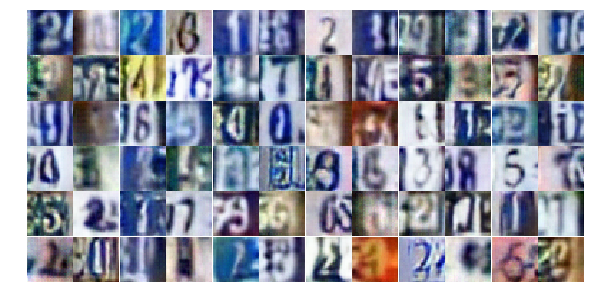

Epoch 13/25... Discriminator Loss: 0.7053... Generator Loss: 0.9148
Epoch 13/25... Discriminator Loss: 0.4955... Generator Loss: 1.4465
Epoch 13/25... Discriminator Loss: 0.6882... Generator Loss: 1.0685
Epoch 13/25... Discriminator Loss: 0.6901... Generator Loss: 0.9787
Epoch 13/25... Discriminator Loss: 0.7838... Generator Loss: 0.8876
Epoch 13/25... Discriminator Loss: 0.8354... Generator Loss: 0.7824
Epoch 13/25... Discriminator Loss: 1.0426... Generator Loss: 2.5841
Epoch 13/25... Discriminator Loss: 0.5292... Generator Loss: 1.3908
Epoch 13/25... Discriminator Loss: 0.5209... Generator Loss: 1.3356
Epoch 13/25... Discriminator Loss: 0.5374... Generator Loss: 1.5599


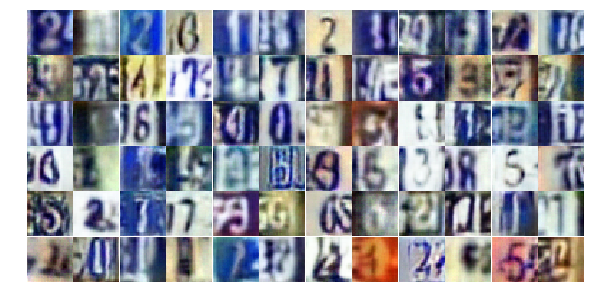

Epoch 13/25... Discriminator Loss: 0.7475... Generator Loss: 0.9019
Epoch 13/25... Discriminator Loss: 0.6644... Generator Loss: 1.2172
Epoch 13/25... Discriminator Loss: 1.1977... Generator Loss: 3.2035
Epoch 13/25... Discriminator Loss: 1.5678... Generator Loss: 0.3358
Epoch 13/25... Discriminator Loss: 0.7254... Generator Loss: 1.0522
Epoch 13/25... Discriminator Loss: 0.4457... Generator Loss: 1.8795
Epoch 13/25... Discriminator Loss: 0.5014... Generator Loss: 1.3705
Epoch 13/25... Discriminator Loss: 0.9884... Generator Loss: 0.6779
Epoch 13/25... Discriminator Loss: 0.6521... Generator Loss: 1.0559
Epoch 13/25... Discriminator Loss: 0.5847... Generator Loss: 1.0406


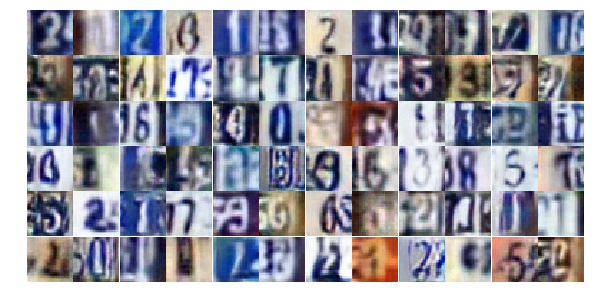

Epoch 13/25... Discriminator Loss: 0.4290... Generator Loss: 1.8903
Epoch 13/25... Discriminator Loss: 1.0439... Generator Loss: 0.5867
Epoch 13/25... Discriminator Loss: 0.8230... Generator Loss: 0.8170
Epoch 13/25... Discriminator Loss: 0.5619... Generator Loss: 1.4161
Epoch 13/25... Discriminator Loss: 1.1482... Generator Loss: 0.5095
Epoch 13/25... Discriminator Loss: 0.7220... Generator Loss: 1.4799
Epoch 13/25... Discriminator Loss: 1.1217... Generator Loss: 0.5353
Epoch 13/25... Discriminator Loss: 0.8828... Generator Loss: 0.7939
Epoch 13/25... Discriminator Loss: 0.4685... Generator Loss: 1.6230
Epoch 13/25... Discriminator Loss: 1.7652... Generator Loss: 0.2885


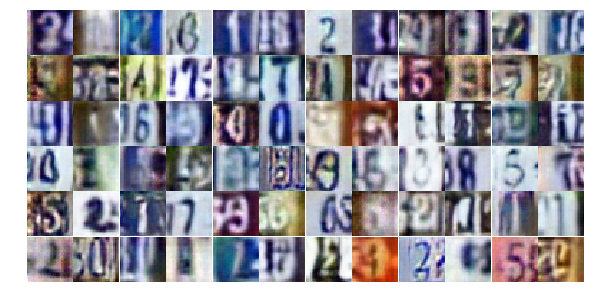

Epoch 13/25... Discriminator Loss: 0.3151... Generator Loss: 1.9387
Epoch 13/25... Discriminator Loss: 0.9844... Generator Loss: 0.6479
Epoch 13/25... Discriminator Loss: 0.5987... Generator Loss: 1.1389
Epoch 13/25... Discriminator Loss: 0.8926... Generator Loss: 1.1564
Epoch 14/25... Discriminator Loss: 0.7127... Generator Loss: 1.2421
Epoch 14/25... Discriminator Loss: 0.5214... Generator Loss: 1.5262
Epoch 14/25... Discriminator Loss: 0.8273... Generator Loss: 0.9183
Epoch 14/25... Discriminator Loss: 0.4944... Generator Loss: 1.5966
Epoch 14/25... Discriminator Loss: 0.7089... Generator Loss: 1.0119
Epoch 14/25... Discriminator Loss: 0.6846... Generator Loss: 1.0621


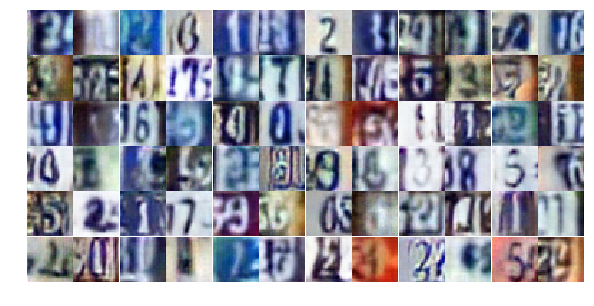

Epoch 14/25... Discriminator Loss: 0.9491... Generator Loss: 2.0231
Epoch 14/25... Discriminator Loss: 0.8937... Generator Loss: 0.6927
Epoch 14/25... Discriminator Loss: 0.6361... Generator Loss: 0.9787
Epoch 14/25... Discriminator Loss: 0.8548... Generator Loss: 0.7156
Epoch 14/25... Discriminator Loss: 0.8290... Generator Loss: 0.7603
Epoch 14/25... Discriminator Loss: 0.4335... Generator Loss: 1.4284
Epoch 14/25... Discriminator Loss: 0.3450... Generator Loss: 1.8534
Epoch 14/25... Discriminator Loss: 1.6044... Generator Loss: 0.3215
Epoch 14/25... Discriminator Loss: 1.1870... Generator Loss: 0.5901
Epoch 14/25... Discriminator Loss: 1.2974... Generator Loss: 0.4543


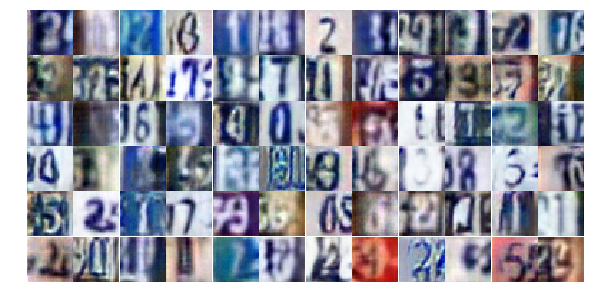

Epoch 14/25... Discriminator Loss: 0.4276... Generator Loss: 1.4109
Epoch 14/25... Discriminator Loss: 0.5102... Generator Loss: 1.4412
Epoch 14/25... Discriminator Loss: 1.1175... Generator Loss: 0.5813
Epoch 14/25... Discriminator Loss: 0.4358... Generator Loss: 1.5410
Epoch 14/25... Discriminator Loss: 1.0717... Generator Loss: 0.5758
Epoch 14/25... Discriminator Loss: 0.7144... Generator Loss: 1.0414
Epoch 14/25... Discriminator Loss: 0.8854... Generator Loss: 0.7451
Epoch 14/25... Discriminator Loss: 0.6271... Generator Loss: 1.0334
Epoch 14/25... Discriminator Loss: 0.5246... Generator Loss: 1.2411
Epoch 14/25... Discriminator Loss: 0.3849... Generator Loss: 2.2633


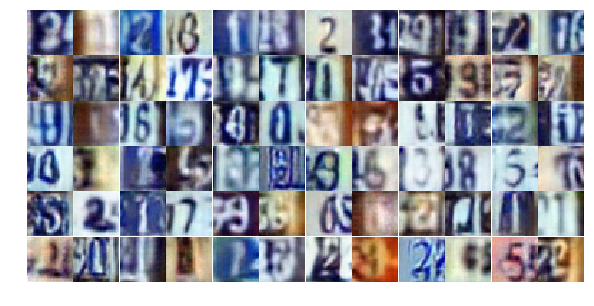

Epoch 14/25... Discriminator Loss: 1.7290... Generator Loss: 0.2622
Epoch 14/25... Discriminator Loss: 0.3693... Generator Loss: 1.7728
Epoch 14/25... Discriminator Loss: 0.4933... Generator Loss: 1.7036
Epoch 14/25... Discriminator Loss: 0.4103... Generator Loss: 1.5991
Epoch 14/25... Discriminator Loss: 0.4445... Generator Loss: 1.4507
Epoch 14/25... Discriminator Loss: 0.8119... Generator Loss: 0.8616
Epoch 14/25... Discriminator Loss: 0.7839... Generator Loss: 0.8547
Epoch 14/25... Discriminator Loss: 0.4107... Generator Loss: 2.3239
Epoch 14/25... Discriminator Loss: 0.6831... Generator Loss: 3.0735
Epoch 14/25... Discriminator Loss: 0.8011... Generator Loss: 1.6916


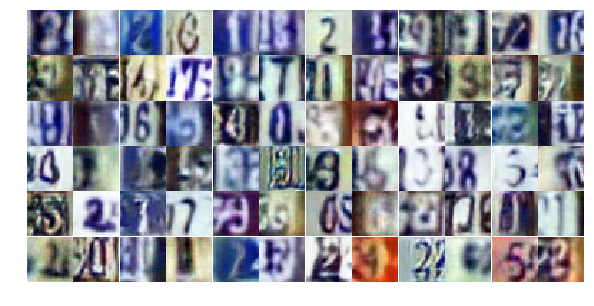

Epoch 14/25... Discriminator Loss: 1.0392... Generator Loss: 0.6747
Epoch 14/25... Discriminator Loss: 0.7484... Generator Loss: 1.1304
Epoch 14/25... Discriminator Loss: 1.0051... Generator Loss: 0.6690
Epoch 14/25... Discriminator Loss: 0.6261... Generator Loss: 1.0394
Epoch 14/25... Discriminator Loss: 0.5552... Generator Loss: 1.2705
Epoch 14/25... Discriminator Loss: 1.0105... Generator Loss: 0.7332
Epoch 14/25... Discriminator Loss: 0.9280... Generator Loss: 0.7123
Epoch 14/25... Discriminator Loss: 0.4596... Generator Loss: 1.6816
Epoch 14/25... Discriminator Loss: 3.3041... Generator Loss: 5.3277
Epoch 14/25... Discriminator Loss: 2.0525... Generator Loss: 0.2251


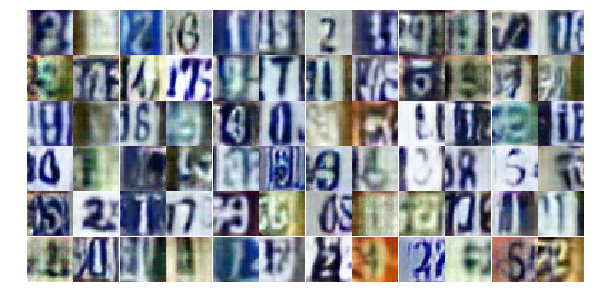

Epoch 14/25... Discriminator Loss: 1.1691... Generator Loss: 2.1231
Epoch 14/25... Discriminator Loss: 1.1290... Generator Loss: 0.5391
Epoch 14/25... Discriminator Loss: 0.5291... Generator Loss: 1.5118
Epoch 14/25... Discriminator Loss: 1.1671... Generator Loss: 0.5440
Epoch 14/25... Discriminator Loss: 0.7310... Generator Loss: 0.9234
Epoch 14/25... Discriminator Loss: 0.5296... Generator Loss: 1.4477
Epoch 14/25... Discriminator Loss: 0.6346... Generator Loss: 1.5339
Epoch 14/25... Discriminator Loss: 0.9371... Generator Loss: 0.7457
Epoch 14/25... Discriminator Loss: 1.0031... Generator Loss: 0.6261
Epoch 14/25... Discriminator Loss: 0.7857... Generator Loss: 0.9189


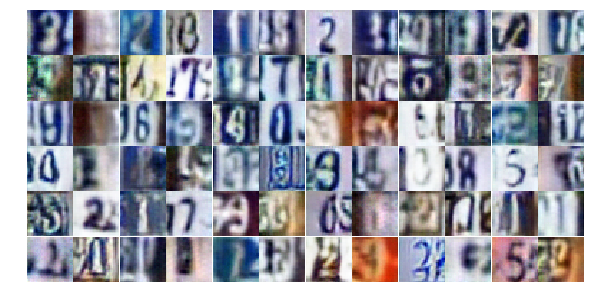

Epoch 14/25... Discriminator Loss: 0.8230... Generator Loss: 0.9703
Epoch 14/25... Discriminator Loss: 0.6290... Generator Loss: 1.1954
Epoch 15/25... Discriminator Loss: 0.6929... Generator Loss: 0.8935
Epoch 15/25... Discriminator Loss: 0.4600... Generator Loss: 1.9553
Epoch 15/25... Discriminator Loss: 0.5920... Generator Loss: 1.1107
Epoch 15/25... Discriminator Loss: 1.1723... Generator Loss: 0.5010
Epoch 15/25... Discriminator Loss: 1.0188... Generator Loss: 0.6187
Epoch 15/25... Discriminator Loss: 0.6647... Generator Loss: 0.9790
Epoch 15/25... Discriminator Loss: 1.0573... Generator Loss: 0.6387
Epoch 15/25... Discriminator Loss: 0.8805... Generator Loss: 0.7601


KeyboardInterrupt: 

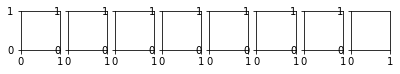

In [17]:
dataset = Dataset(trainset, testset)

losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

In [ ]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

In [ ]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

In [ ]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))

In [ ]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))